In [1]:
import itertools
from operator import itemgetter
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import seaborn as sns
sns.set_theme(color_codes=False)
import scipy as sp
import numpy as np
import math
from numbers import Number
import torch_geometric
import geopandas as gpd
import pandas as pd
import osmnx as ox
import momepy
import fiona
import networkx as nx
from sklearn.manifold import TSNE
from pysal.explore import esda
from pysal.lib import weights
from torch_geometric.data import Data, Batch
from torch_geometric.transforms import RandomLinkSplit, LocalDegreeProfile
import pickle

from train import run
from prediction import print_naive_metrics, load_data
from utils.visualization import visualize_graph, visualize_nx, plot_loss_curve
from utils.utils import remove_item
from utils.gdf_to_nx import gdf_to_nx
from utils.load_geodata import load_graph, load_gdf, construct_accident_dataset
from utils.load_data import load_gva_df, load_deprivation_df
from utils.constants import *

/vol/bitbucket/wwc4618/venv/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/vol/bitbucket/wwc4618/venv/lib/python3.8/site-packages/spaghetti/network.py:36: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(f"{dep_msg}", FutureWarning)


In [8]:
from sklearn.preprocessing import robust_scale, maxabs_scale, minmax_scale, power_transform, quantile_transform

def sum_to_one_scale(X):
    X = X - X.min()
    return X.div_(X.sum(dim=0, keepdim=True).clamp_(min=1.))

test_feats = torch.tensor([[38.040542, 0.23], [79.979896, 0.35], [82.964631, 1.0], [66.346828, 0.9], [29.551825, 0.05]])
print(sum_to_one_scale(test_feats))
# full_gdf = gpd.read_file(f'{dataset_root}/OpenMapping-gb-v1_gpkg/gpkg/ssx_openmapping_gb_v1.gpkg', ignore_fields=fields_to_ignore)

norm_dict = {
    'minmax': minmax_scale,
    'power': power_transform,
    'quantile': quantile_transform
}
# for norm in norm_dict:
#     norm_fn = norm_dict[norm]
#     norm_fields = [f'{field}{norm}' for field in unnorm_feature_fields]
#     df = pd.DataFrame.from_records(norm_fn(full_gdf[unnorm_feature_fields]), columns=norm_fields)
#     full_gdf = pd.concat([full_gdf, df], axis=1)
# full_gdf = pd.read_pickle(f'{dataset_root}/filtered_norm_openmapping.pt')
# full_gdf.head()

tensor([[0.1281, 0.0789],
        [0.2695, 0.1316],
        [0.2795, 0.4167],
        [0.2235, 0.3728],
        [0.0995, 0.0000]])


In [2]:
# b = pickle.load(open(f'{dataset_root}/saved_graphs/saved_data_files.pt', 'rb'))
# b
# values = [f'accident_transductive_cut_{agg}_pyg.pt' for agg in [
#         'mean', 'median'
#     ]] + [f'accident_inductive_cut_{agg}_pyg.pt' for agg in [
#         'mean', 'median'
#     ]]
# for value in values:
#     key = list(b.keys())[list(b.values()).index(value)]
#     if key[2] == 'meridian_class':
#         del b[key]
# pickle.dump(b, open(f'{dataset_root}/saved_graphs/saved_data_files.pt', 'wb'))

# Playground

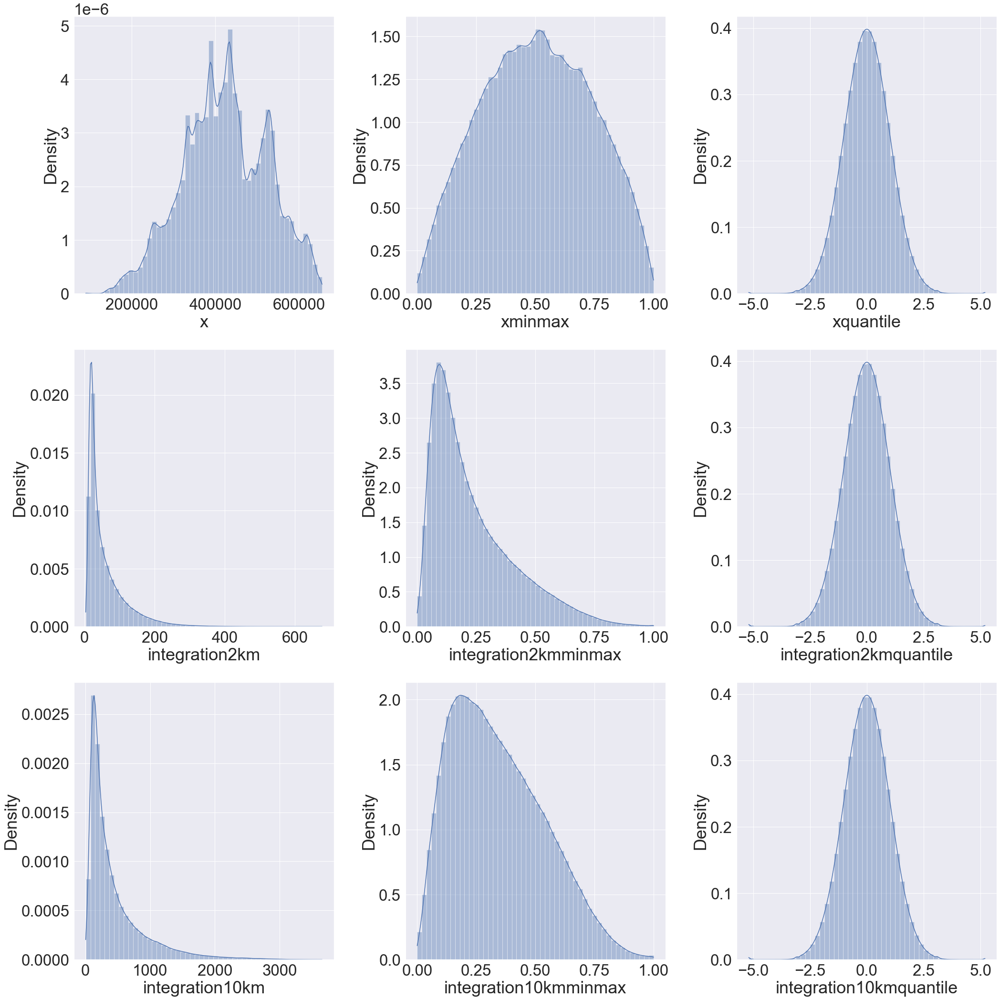

In [29]:
from sklearn.preprocessing import robust_scale, maxabs_scale, minmax_scale, power_transform, quantile_transform
from functools import partial

dataset = torch.load(f'{dataset_root}/ssx_dataset_min.pt')

attrs = ['x', 'integration2km', 'integration10km']
norms = {'': (lambda x: x.numpy()), 'minmax': minmax_scale, 'quantile': partial(quantile_transform, output_distribution='normal')}
# full_gdf = pd.DataFrame(columns=[f'{attr}{norm}' for attr in attrs for norm in norms])

dict_df = {f'{attr}{norm}': [] for attr in attrs for norm in norms}
for data in dataset:
    for attr in attrs:
        idx = data.node_attrs.index(attr)
        items = data.x[:, idx:idx+1]
        for norm in norms:
            new_vals = norms[norm](items).flatten()
            dict_df[f'{attr}{norm}'].extend(list(new_vals))
            
full_gdf = pd.DataFrame.from_dict(dict_df,orient='index').transpose()
         
sns.set(font_scale=3)
fig, axs = plt.subplots(3, 3, figsize=(30,30))
axs0, axs1 = axs[0], axs[1]

kde_kws = {'cut': 0}

metrics = [f'{attr}{norm}' for attr in attrs for norm in norms]
i=0
for ax_ in axs:
    for ax in ax_:
        sns.distplot(full_gdf[metrics[i]], ax=ax, kde_kws=kde_kws)
        i += 1
plt.tight_layout()
plt.savefig('normalization_plot.png', bbox_inches='tight')

In [15]:
sum_dict = torch.load(f'{dataset_root}/model_runs/link_pred_sum_feat_runs.pt')
quantile_dict = torch.load(f'{dataset_root}/model_runs/link_pred_quantile_norm_feat_runs.pt')
result_dict_ = torch.load('./result_dict.pt')
result_dict = {
    'Rank Integration ': sum_dict["['integration2kmrank', 'integration10kmrank']"],
    'Minmax Coordinate': result_dict_["{'include_feats': ['x', 'y'], 'scaler': 'minmax'}"],
    'Minmax Integration': result_dict_["{'include_feats': ['integration2km', 'integration10km'], 'scaler': 'minmax'}"],
    'Quantile Coordinate': quantile_dict["['x', 'y']"],
    'Quantile Integration': quantile_dict["['integration2km', 'integration10km', 'integration100km']"],
    'Quantile Coordinate & Integration': result_dict_["{'include_feats': ['x', 'y', 'integration2km', 'integration10km'], 'scaler': 'quantile-normal'}"],
}

12


,model,total_loss,train_auc,train_ap,test_auc,test_ap,sec_per_epoch,model_details
0,"['x', 'y']",0.052375,0.953974,0.730922,0.953641,0.727284,3.354188,)
1,"['x', 'y']",0.038736,0.968588,0.811219,0.970811,0.821357,3.265055,)
2,"['x', 'y']",0.045250,0.961705,0.773420,0.963415,0.780907,3.277667,)
3,"['x', 'y']",0.038089,0.967584,0.809369,0.968455,0.813537,3.288015,)
4,"['x', 'y']",0.046665,0.960047,0.757175,0.961426,0.762142,3.252928,)
5,"['choice2km', 'nodecount2km', 'integration2km']",0.055553,0.920685,0.659100,0.921336,0.658469,3.407177,)
6,"['choice2km', 'nodecount2km', 'integration2km']",0.072900,0.892794,0.553647,0.893469,0.553045,3.478653,)
7,"['choice2km', 'nodecount2km', 'integration2km']",0.056212,0.919108,0.658512,0.920344,0.661804,3.456356,)
8,"['choice2km', 'nodecount2km', 'integration2km']",0.071842,0.901591,0.595997,0.903120,0.595711,3.517899,)
9,"['choice2km', 'nodecount2km', 'integration2km']",0.074309,0.896285,0.566900,0.897902,0.569080,3.506555,)


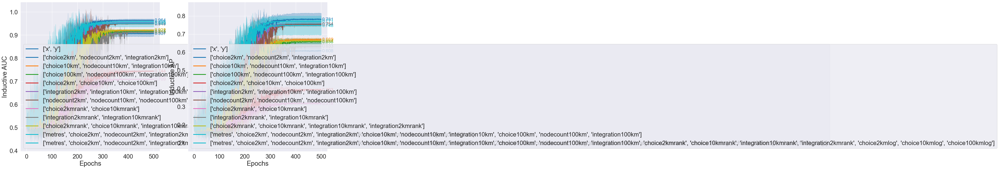

In [11]:
# View results
result_dict = {
    # **torch.load(f'{dataset_root}/meridian_inductive_model_runs.pt'),
    **torch.load(f'{dataset_root}/model_runs/link_pred_fixedsum_feat_runs.pt'),
    # **torch.load(f'{dataset_root}/meridian_inductive_loader_runs3.pt'),
    # **torch.load(f'{dataset_root}/meridian_inductive_loader_runs4.pt'),
}

# rename_dict = {
#     "{'model_type': 'gcn', 'distmult': True}": 'GCN',
#     "{'model_type': 'gat', 'distmult': True}": 'GAT',
#     "{'model_type': 'sage', 'distmult': True, 'aggr': 'max'}": 'SAGE',
#     "{'model_type': 'gin', 'distmult': True}": 'GIN',
#     "{'model_type': 'gain', 'distmult': True}": 'GAIN'
# }

# for i in rename_dict:
#     result_dict[rename_dict[i]] = result_dict.pop(i)
# rename_dict =
# result_dict = {
#     'Rank Integration ': sum_dict["['integration2kmrank', 'integration10kmrank']"],
#     'Quantile Coordinate': quantile_dict["['x', 'y']"],
#     'Quantile Integration': quantile_dict["['integration2km', 'integration10km', 'integration100km']"],
#     'Quantile Coordinate & Integration': result_dict_["{'include_feats': ['x', 'y', 'integration2km', 'integration10km'], 'scaler': 'quantile-normal'}"],
# }

def plot_loss_curve(losses, label, ax=None, color=None, show_std=True,
                    annotate_last=True, annotate_offset=0,  **plot_kwargs):
    if ax is None:
        _, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.set_title('Validation Loss over training')
        ax.set_xlabel('Epochs')
        ax.set_ylabel('Validation Loss')
    
    epochs = np.arange(1, len(losses[0]) + 1)
    losses_mean = np.mean(losses, axis=0)
    losses_std = np.std(losses, axis=0)
    
    if color is None:
        color = 'g'
    # Plot learning curve and error margin 
    if show_std:
        ax.fill_between(
            epochs,
            losses_mean - losses_std,
            losses_mean + losses_std,
            alpha=0.3,
            color=color,
        )
    ax.plot(
        epochs, losses_mean, color=color, label=label, **plot_kwargs
    )
    
    if annotate_last:
        last_value = losses_mean[-1]
        ax.annotate('%0.3f' % last_value, xy=(1, last_value), xytext=(-20, -5 - annotate_offset),
                 xycoords=('axes fraction', 'data'), textcoords='offset points', fontsize='x-small', color=color)
        
    ax.legend(loc="best")

    return ax

from pylab import *
n_classes = len(result_dict)
print(n_classes)
cmap_name = 'tab10'
cmap = cm.get_cmap(cmap_name, n_classes)
colors = [matplotlib.colors.rgb2hex(cmap(i)) for i in range(cmap.N)]
# colors = ['#377eb8', '#ff7f00', '#4daf4a', '#a65628', '#984ea3',
#                   '#e41a1c', '#dede00'][:n_classes]
sns.set(font_scale=2)
f, axs = plt.subplots(1, 2, figsize=(20, 10))
ax = axs[0]
ax.set_xlabel('Epochs')
ax.set_ylabel('Inductive AUC')
metric = 'test_auc'
for idx, label in enumerate(result_dict):
    loss_curves = [iter_res[metric] for iter_res in result_dict[label]]
    ax = plot_loss_curve(loss_curves, label, ax=ax, color=colors[idx], linewidth=3)
                        # annotate_offset=[0, 5, 0, 0, 0, -8][idx])
ax = axs[1]
ax.set_xlabel('Epochs')
ax.set_ylabel('Inductive AP')
metric = 'test_ap'
for idx, label in enumerate(result_dict):
    loss_curves = [iter_res[metric] for iter_res in result_dict[label]]
    ax = plot_loss_curve(loss_curves, label, ax=ax, color=colors[idx], linewidth=3)

plt.savefig('quantile_curves.png', bbox_inches='tight')
import pandas as pd
pd.set_option('display.max_colwidth', -1)
pd.set_option('display.max_rows', None)
records = []
for model in result_dict:
    for iter_res in result_dict[model]:
        metrics = {}
        for key in iter_res:
            if not isinstance(iter_res[key], Number) and len(iter_res[key]) > 0:
                metrics[key] = iter_res[key][-1]
            else:
                metrics[key] = iter_res[key]
        # metrics = {
        #     key: iter_res[key][-1]
        #     for key in iter_res
        #     if len(iter_res[key]) > 0 and key != 'total_loss'
        # }
        
        records.append({ 'model': model, **metrics })
result_df = pd.DataFrame.from_records(records)
result_df
# result_df[['model', 'MAE', 'RMSE', 'Inductive MAE', 'Inductive RMSE', 'sec_per_epoch', 'model_parameters']]
# result_df[['model', 'Weighted F1', 'MCC', 'Inductive Weighted F1', 'Inductive MCC', 'sec_per_epoch', 'model_parameters']]

NameError: name 'distmult_res' is not defined

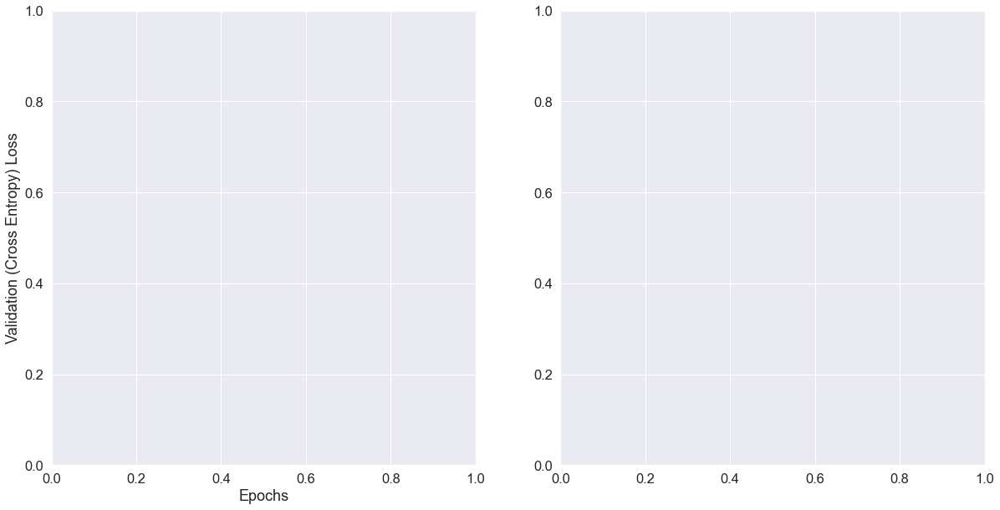

In [14]:
models_to_show = {
    'Neighbor (GraphSAGE)': str({'split_approach': 'neighbor', 'batch_size': 4096}),
    'Cluster-GCN': str({'split_approach': 'cluster', 'num_parts': 512, 'batch_size': 16}),
    'SAINT-RW': str({'split_approach': 'saint', 'batch_size': 160000}), 
    'Full Batch': str({'split_approach': 'none'}), 
}
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']

sns.set(font_scale=1.5)
# colors = ['r', 'g', 'b', 'orange']
f, axs = plt.subplots(1, 2, figsize=(20, 10))
metric = 'Val Loss'
ax = axs[0]
ax.set_xlabel('Epochs')
ax.set_ylabel('Validation (Cross Entropy) Loss')
for idx, label in enumerate(models_to_show):
    loss_curves = [iter_res[metric] for iter_res in distmult_res[models_to_show[label]]]
    ax = plot_loss_curve(loss_curves, label, ax=ax, color=colors[idx])
ax = axs[1]
metric='MCC'
ax.set_xlabel('Epochs')
ax.set_ylabel('Validation MCC')
for idx, label in enumerate(models_to_show):
    loss_curves = [iter_res[metric] for iter_res in distmult_res[models_to_show[label]]]
    ax = plot_loss_curve(loss_curves, label, ax=ax, color=colors[idx])
plt.savefig('loader_loss.png', bbox_inches='tight')

In [ ]:
# Visualizes the LA with the top k link pred accuracy
link_pred1 = torch.load(f'{dataset_root}/link_pred/transductive_metrics_primal_1.pt')
link_pred2 = torch.load(f'{dataset_root}/link_pred/transductive_metrics_primal_2.pt')

net_df = pd.read_pickle(f'{dataset_root}/network_df.pt')

stats = ['average_degree', 'num_nodes', 'num_edges', 'density', 'transitivity',
       'average_shortest_path_length', 'diameter']
ssx_stats = ['metres', 'choice2km',
       'nodecount2km', 'integration2km', 'choice10km', 'nodecount10km',
       'integration10km', 'choice100km', 'nodecount100km', 'integration100km',
       'choice2kmrank', 'choice10kmrank', 'integration10kmrank',
       'integration2kmrank', 'choice2kmlog', 'choice10kmlog',
       'choice100kmlog']
link_pred = {**link_pred1, **link_pred2}
place_ap_dict = {}
metrics = ['total_loss', 'train_auc', 'train_ap', 'sec_per_epoch', 'model_details', 'filtered_f1', 'roc', 'pr']
for place in link_pred:
    average_ap = np.mean(link_pred[place]['train_ap'], axis=0)
    place_ap_dict[place] = average_ap
sorted_dict = {k: v for k, v in sorted(place_ap_dict.items(), key=lambda item: item[1])}    
k = 3

f, axs = plt.subplots(2, 3, figsize=(15,12))
for i in range(k):
    for j, idx in enumerate([-i -1, i]):
        place, metric = list(sorted_dict.items())[idx]
        print(place)
        place_df = net_df.query(f'place == "{place}"')
        graph = load_graph(place, return_nx=True, clean=False, approach='primal')
        ax = axs[j][i]
        title = f'{place}, {place_df["num_nodes"].values[0]} nodes\n'
        title += f'AP: {metric:.3f}, Avg. Degree: {place_df["average_degree"].values[0]:.2f}'
        ax.set_title(title, fontsize=20)
        visualize_nx(graph, ax=axs[j][i], node_size=1)
plt.tight_layout()

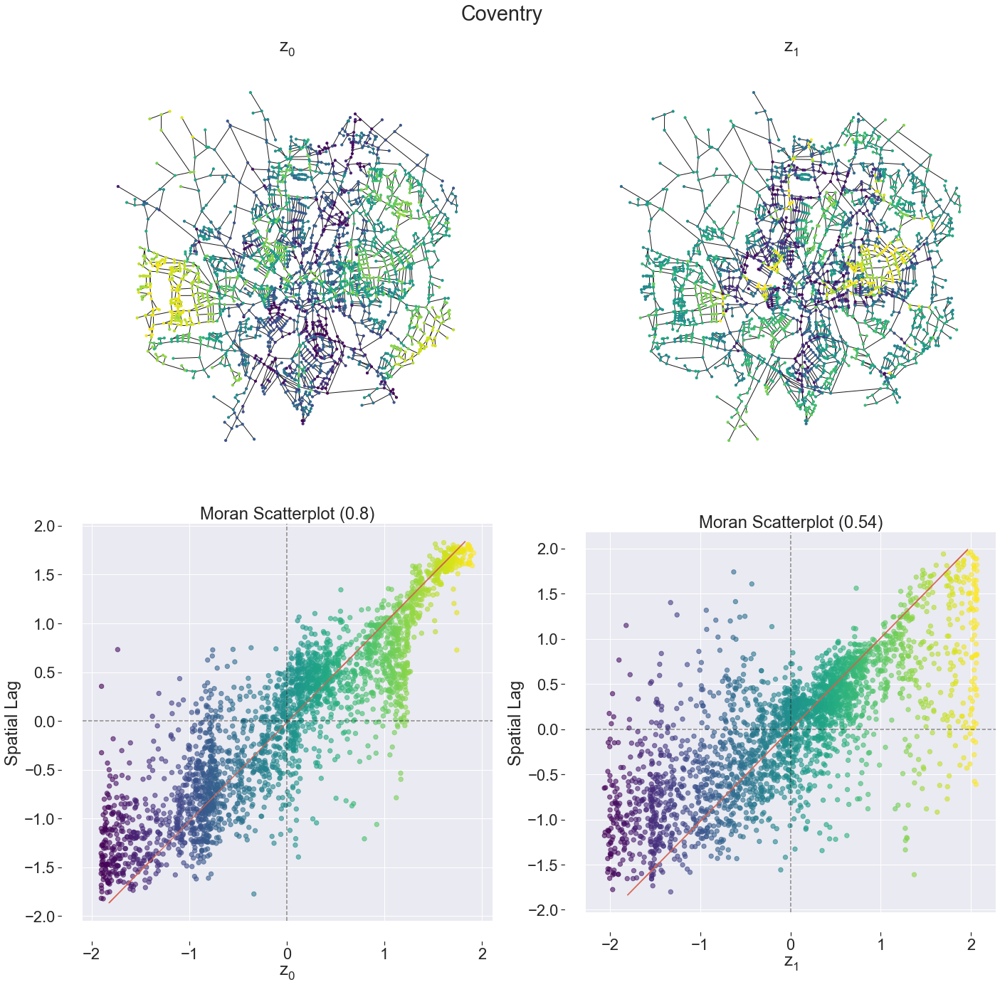

In [23]:
link_pred_metrics = torch.load(f'{dataset_root}/link_pred/clean_link_pred.pt')[1]
place = 'Coventry'
k = 2
G = load_graph(place, return_nx=True, clean=True, approach='primal')
enc = link_pred_metrics[place]['z']
tsne = TSNE(n_components=k, learning_rate='auto', init='random')
enc = tsne.fit_transform(enc)
ssx_gdf = load_gdf('No Bounds', clean=False)
df = []
for i, (node, d) in enumerate(G.nodes(data=True)):
    z = enc[i]
    for i, z_i in enumerate(z):
        d[f'z_{i}'] = z_i
    df.append(d)
df = pd.DataFrame(df)
# Build GeoDataFrame of latent vectors and node coordinates
gdf = gpd.GeoDataFrame(
    df, 
    geometry=gpd.points_from_xy(df.x, df.y),
    crs=ssx_gdf.crs
)

params = {'mathtext.default': 'regular' }          
plt.rcParams.update(params)

sns.set(font_scale=2)
fig, axss = plt.subplots(2, 2, figsize=(20, 20))
axs = axss[0]
colors = [node[1]['z_0'] for node in G.nodes(data=True)]
nx.draw(G, {n:[n[0], n[1]] for n in list(G.nodes)}, node_size=10, node_color=colors, cmap='viridis', ax=axs[0])
axs[0].set_title('$z_0$')
colors = [node[1]['z_1'] for node in G.nodes(data=True)]
nx.draw(G, {n:[n[0], n[1]] for n in list(G.nodes)}, node_size=10, node_color=colors, cmap='viridis', ax=axs[1])
axs[1].set_title('$z_1$')
plt.suptitle(f'{place}', y=0.98)

axs = axss[1]
from splot.esda import moran_scatterplot
w = weights.KNN.from_dataframe(gdf, k=8)
w.transform = 'R'

moran_bv = esda.moran.Moran(gdf['z_0'], w)
scatter_kwds = {'c': gdf['z_0'].values.tolist(), 'color': None, 'cmap': 'viridis'}
moran_scatterplot(moran_bv, ax=axs[0], scatter_kwds=scatter_kwds)
axs[0].set_xlabel('$z_0$')
moran_bv = esda.moran.Moran(gdf['z_1'], w)
scatter_kwds = {'c': gdf['z_1'].values.tolist(), 'color': None, 'cmap': 'viridis'}
# moran_loc_bv = esda.moran.Moran_Local_BV(gdf['z_0'], gdf['z_1'], w)
moran_scatterplot(moran_bv, ax=axs[1], scatter_kwds=scatter_kwds)
axs[1].set_xlabel('$z_1$')
plt.tight_layout()

(<Figure size 720x288 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.72', ylabel='Density'>,
        <AxesSubplot:title={'center':'Moran Scatterplot (0.72)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

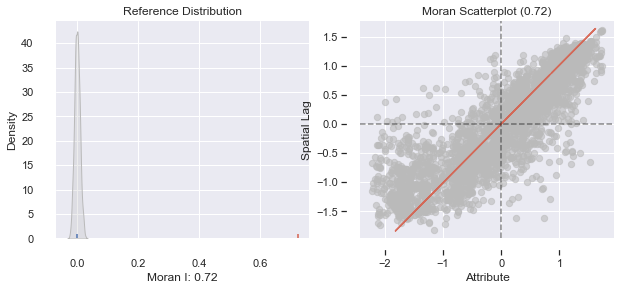

In [14]:
from splot.esda import plot_moran, Moran_Local,  lisa_cluster
w = weights.KNN.from_dataframe(gdf, k=8)
w.transform = 'R'
moran = esda.moran.Moran(gdf['z_0'], w)
print(moran.p_sim)
plot_moran(moran)


# calculate Moran_Local and plot
moran_loc = Moran_Local(y, w)
lisa_cluster(moran_loc, gdf, p=0.05, figsize = (9,9))
plt.show()
# def moran_i(db, label):
#     w = weights.KNN.from_dataframe(db, k=k)
#     w.transform = 'R'
#     lag_col = f'{label}_lag'
#     db[lag_col] = weights.spatial_lag.lag_spatial(
#         w, db[label]
#     )
#     db[f'{label}_std'] = ( db[label] - db[label].mean() )
#     db[f'{lag_col}_std'] = ( db[lag_col] - db[lag_col].mean() )
#     f, ax = plt.subplots(1, figsize=(10, 10))
#     sns.regplot(
#         x=f'{label}_std',
#         y=f'{lag_col}_std', 
#         ci=None,
#         data=db,
#         line_kws={'color':'r'}
#     )
#     ax.axvline(0, c='k', alpha=0.5)
#     ax.axhline(0, c='k', alpha=0.5)
#     ax.set_title('Moran Plot - % Leave')
#     plt.show()
    
# moran_i(gdf, 'z_0')
# moran_i(gdf, 'z_1')




Loading graph of ['Isle of Wight', 'Wycombe', 'Enfield', 'Slough', 'South Bucks', 'Hillingdon', 'Ealing', 'Chiltern', 'Copeland', 'Windsor and Maidenhead', 'Plymouth', 'South Hams', 'Oxford', 'Waltham Forest', 'Mendip', 'Dudley', 'Cotswold', 'Erewash', 'Redbridge', 'Epping Forest', 'Test Valley', 'Basingstoke and Deane', 'South Gloucestershire', 'Woking', 'Broxbourne', 'Wolverhampton', 'Wiltshire', 'Swindon', 'Bath and North East Somerset', 'Trafford', 'Salford', 'South Staffordshire', 'West Oxfordshire', 'Malvern Hills', 'Vale of White Horse', 'South Kesteven', 'North Kesteven', 'Guildford', 'Southwark', 'Chichester', 'Waverley', 'Elmbridge', 'Forest of Dean', 'Tewkesbury', 'Charnwood', 'Sheffield', 'Ashfield', 'North West Leicestershire', 'North East Derbyshire', 'Stroud', 'Shropshire', 'Telford and Wrekin', 'Horsham', 'City of London', 'Newcastle-under-Lyme', 'Stafford', 'Stoke-on-Trent', 'Arun', 'Lichfield', 'Sandwell', 'Birmingham', 'Amber Valley', 'Mole Valley', 'Bolsover', 'Rush

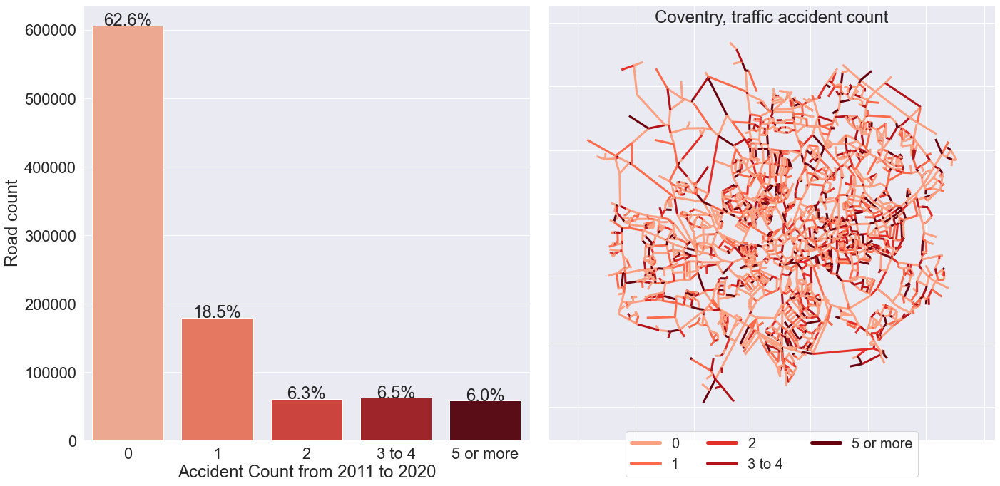

In [60]:
sns.set(font_scale = 2)
_, axs = plt.subplots(1, 2, figsize=(20, 10))
ax0, ax1 = axs

"""
LEFT PLOT
"""
clean = True
agg = 'min'
dist = 15
target_field = 'accident_count'
include_feats = all_feature_fields
data = load_graph(transductive_places,
                  feature_fields=include_feats,
                  force_connected=True, 
                  approach='dual',
                  clean=clean,
                  clean_agg=agg,
                  dist=dist,
                  cat_fields=['meridian_class'],
                  verbose=True,
                  target_field=target_field)
# color_dict ={
#     '0': '#808080',
#     '1': '#440154', 
#     '2': '#31688e',
#     '3 to 4': '#35b779', 
#     '5 or more': '#fde725'
# }



from pylab import *
n_classes = 5
cmap_name = 'Reds'
cmap = cm.get_cmap(cmap_name, n_classes + 2)    # PiYG

colors = [matplotlib.colors.rgb2hex(cmap(i)) for i in range(2, cmap.N)]
labels = ['0', '1', '2', '3 to 4', '5 or more']
color_dict = { labels[i]: colors[i] for i in range(n_classes) }

from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], color=col, lw=lw) \
                for col, lw in zip(list(color_dict.values()), [5, 5, 5, 5, 5])]
# sns.countplot(data=gdf, x='meridian_class', ax=ax0, order=['minor', 'aroad', 'broad', 'motorway'], palette=['#7f7f7f','#ff7f0e','#1f77b4','#d62728'])
col = 'Accident Count from 2011 to 2020'
gdf = pd.DataFrame(data[target_field].numpy(), columns=[col])
bins = [0, 1, 2, 3, 5, gdf[col].max() + 1]
bin_labels = ['0','1','2', '3 to 4', '5 or more']
gdf2 = pd.cut(gdf[col], bins=bins, labels=bin_labels, right=False)
print(gdf2.head())
sns.countplot(gdf2, ax=ax0, palette=list(color_dict.values()))
ax0.set_ylabel('Road count')
total = float(len(gdf2))
for p in ax0.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total)
    x = p.get_x() + p.get_width()/2
    y = p.get_height() + 100
    ax0.annotate(percentage, (x, y),ha='center')

"""
RIGHT PLOT
"""

place = 'Coventry'
data, _, _ = load_data(place,
                       target_field,
                       categorize='multiclass',
                       include_feats=include_feats,
                       clean=clean,
                       agg=agg,
                       dist=dist,
                       verbose=True)

streets = load_graph(place, target_field=target_field,
                     feature_fields=[],
                     force_connected=True,
                     clean=clean,
                     return_nx=True)

target_dict = {}
target = data.y.cpu()
for i, e in enumerate(streets.edges(keys=True)):
    target_dict[e] = data.classes[int(target[i])]
nx.set_edge_attributes(streets, target_dict, target_field)

colors = [color_dict[d[target_field]] for _, _, d in streets.edges(data=True)]

# widths = [2 if d[target_field] == '0' else 5 for _, _, d in streets.edges(data=True)]
streets.remove_edges_from(nx.selfloop_edges(streets))
nx.draw_networkx(streets, 
                 {n:[n[0], n[1]] for n in list(streets.nodes)},
                 ax=ax1, 
                 node_size=0,
                 width=3,
                 edge_color=colors,
                 with_labels=False)
ax1.patch.set_facecolor('#eaeaf2')
ax1.legend(custom_lines, list(color_dict.keys()), facecolor='white',
                 loc='lower center', bbox_to_anchor=(0.5, -0.1), ncol=3, fontsize='small')
ax1.set_title(f'{place}, traffic accident count', y=0.95)

plt.tight_layout()
plt.savefig('accident_count.png', bbox_inches='tight')
plt.show()

In [4]:
# full_gdf = load_gdf('No Bounds')
# iter_csv = pd.read_csv(f'{dataset_root}/dft-road-casualty-statistics-accidents.csv',
#                               iterator=True, chunksize=1000)
# # Filter by year
# accident_df = pd.concat([chunk[(chunk['accident_year']  >= 2011) & (chunk['accident_year'] <= 2020)] for chunk in iter_csv])

# # Convert to GeoDataFrame
# accident_gdf = gpd.GeoDataFrame(
#     accident_df, 
#     geometry=gpd.points_from_xy(accident_df.location_easting_osgr,
#                                 accident_df.location_northing_osgr),
#     crs=full_gdf.crs
# )

# Spatial join with OpenMapping Dataset, obtaining the closest road segment
# Filters out accidents on non-included roads by limiting distance
# join_gdf = accident_gdf.sjoin_nearest(
#     full_gdf.reset_index(level=0), 
#     how='left', 
#     max_distance=1000, distance_col='dist'
# )
# sns.boxplot(join_gdf['dist'])
join_gdf['dist'].quantile(q=0.9)
# cut_bins = [-1, 0, 1, 3, np.inf]
# cut_labels = ['No Accidents', 'One Accident', 'Few Accidents', 'Many Accidents']
# place_gdf['accident_cat'] = pd.cut(place_gdf['accident_count'], bins=cut_bins, labels=cut_labels)
# place_gdf['accident_cat'].dtype

14.916812125860913

In [51]:

line_G

(426031.4, 439574.6, 273594.5, 285969.5)

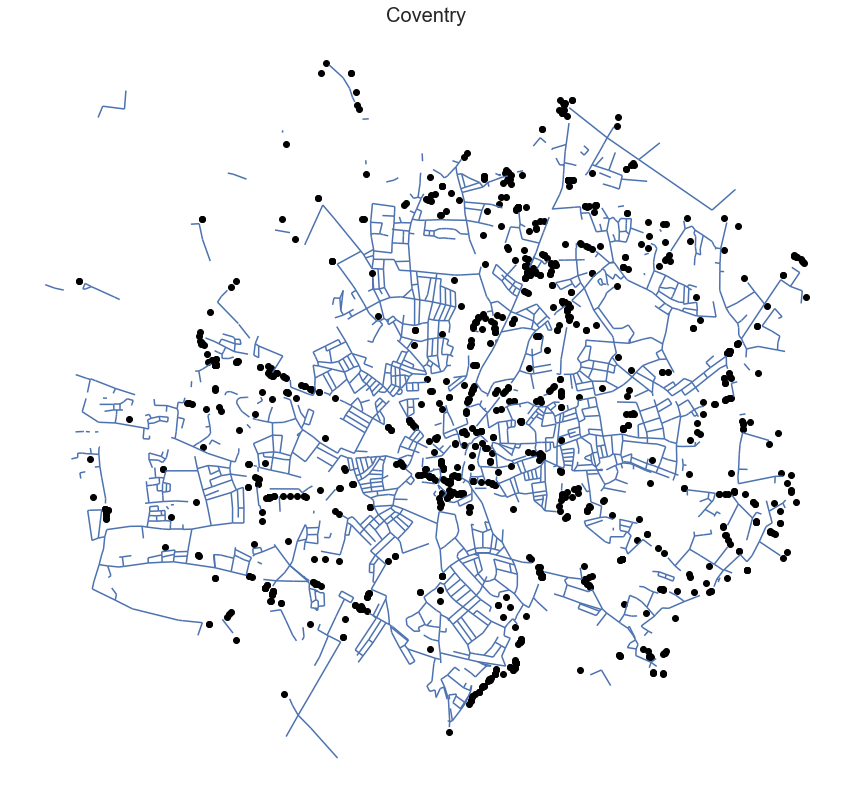

In [8]:

place = join_gdf[(join_gdf['dist'] > 50)]['lad11nm'].mode()[0]

kesteven_gdf_accidents = join_gdf[(join_gdf['dist'] > 50) & \
                                  (join_gdf['lad11nm'] == place)]
kesteven_road_gdf = place_gdf
ax = kesteven_road_gdf.plot(figsize=(15,15))
ax.set_title(place, fontsize=20)
ax = kesteven_gdf_accidents.plot(color='k', ax=ax)
ax.axis('off')

107292744 geometries retrieved from No Bounds


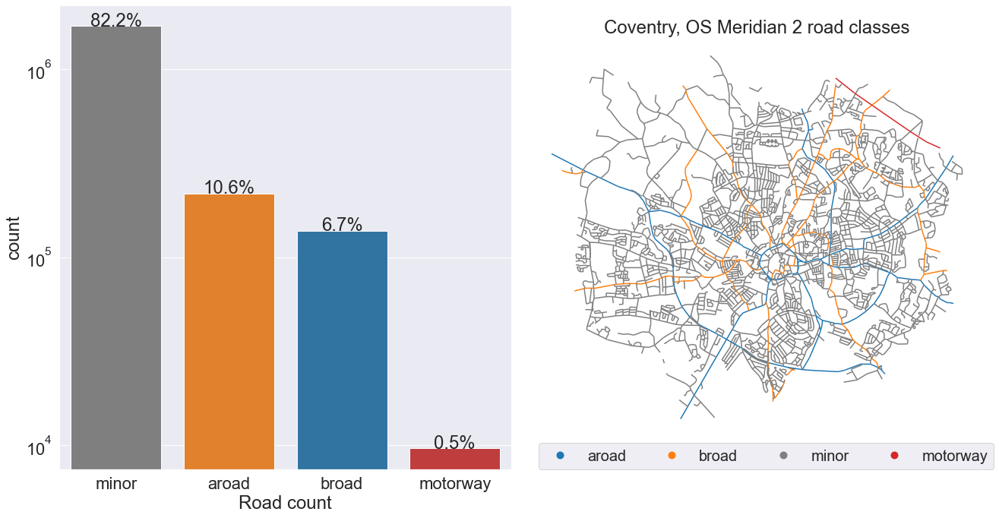

In [8]:
gdf = load_gdf('No Bounds')
sns.set(font_scale = 2)
_, axs = plt.subplots(1, 2, figsize=(20, 10))
ax0, ax1 = axs
# _, axs1 = plt.subfigure(1, 2, figsize=(20, 10))
# data, _, _ = load_data('No Bounds',
#                  'accident_count',
#                   include_feats=all_feature_fields)

import matplotlib.colors as colors


color_dict = {'aroad': '#1f77b4',
             'broad': '#ff7f0e',
             'minor': '#7f7f7f',
             'motorway': '#d62728'}
    
sns.countplot(data=gdf, x='meridian_class', ax=ax0, order=['minor', 'aroad', 'broad', 'motorway'], palette=['#7f7f7f','#ff7f0e','#1f77b4','#d62728'])
ax0.set_yscale("log")
ax0.set_xlabel('Road count')

total = float(len(gdf))
for p in ax0.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total)
    x = p.get_x() + p.get_width()/2
    y = p.get_height() + 40
    ax0.annotate(percentage, (x, y),ha='center')

# sns.distplot(x=accident_gdf['accident_count'], ax=ax4, bins=[0, 1, 3, 6, accident_gdf['accident_count'].max()])
# ax4.set_xscale("log")
place = 'Coventry'
place_gdf = gdf[gdf['lad11nm'] == place]
place_gdf.plot(ax=ax1, column='meridian_class', legend=True,
               legend_kwds={'loc':'lower left', 'ncol':5, 'bbox_to_anchor': (0, -0.1), 'fontsize': 'small'},
               categorical=True, cmap=colors.ListedColormap(list(color_dict.values())))
ax1.axis('off')
ax1.set_title(f'{place}, OS Meridian 2 road classes')
# place_gdf = accident_gdf[accident_gdf['lad11nm'] == place]
# place_gdf['accident_count'].replace(0, np.nan, inplace=True)
# place_gdf.plot(ax=ax2, column='accident_count', legend=True,legend_kwds={'loc':'lower left', 'ncol':3}, cmap='plasma', figsize=(10,10), scheme='Quantiles', k=5, missing_kwds = dict(color='grey', label='0'))
# ax2.axis('off')
# ax2.set_title(f'{place}, accident count quantiles', fontsize=20)

plt.tight_layout()
plt.savefig('meridian_class.png', bbox_inches='tight')
plt.show()

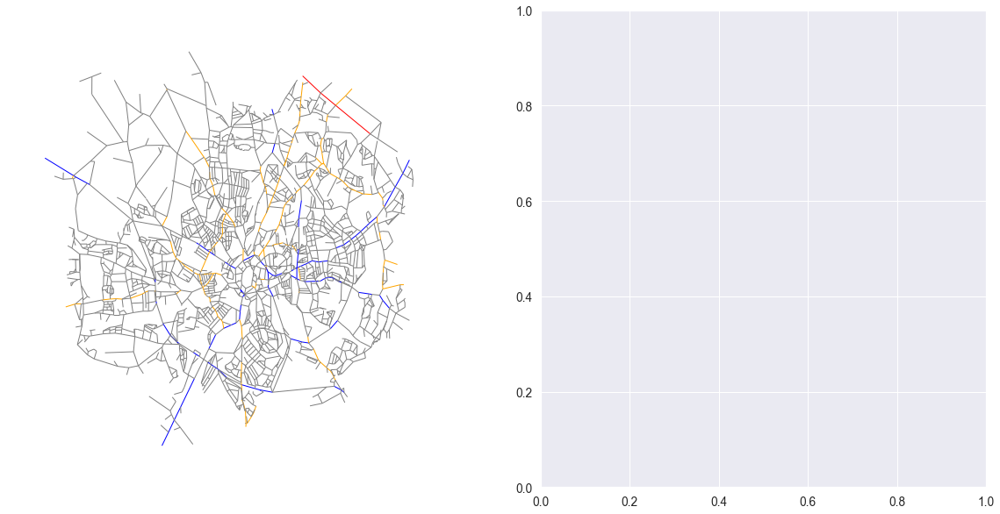

In [23]:


place = 'Coventry'
target_field = 'accident_count'
data = load_graph(place,
                  feature_fields=all_feature_fields,
                  force_connected=True, 
                  approach='primal',
                  clean=True,
                  target_field=target_field,
                  return_nx=True)
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

color_dict = {'aroad': 'blue',
             'broad': 'orange',
             'minor': 'grey',
             'motorway': 'red'}
colors = [color_dict[node[2]['meridian_class']] for node in data.edges(data=True)]

nx.draw(data, {n:[n[0], n[1]] for n in list(data.nodes)}, node_size=0, edge_color=colors, cmap='tab10', ax=axs[0])

In [13]:
from utils.constants import meridian_fields
place = 
gdf_w = load_gdf('No Bounds', ignore_fields=all_feature_fields + fields_to_ignore, clean=True)
gdf_w

,id,oa11cd,wz11cd,lsoa11cd,lsoa11nm,msoa11cd,msoa11nm,lad11cd,lad11nm,geometry,accident_count
0,562327,E00087303,E33041113,E01017285,Isle of Wight 010B,E02003590,Isle of Wight 010,E06000046,Isle of Wight,"LINESTRING (461136.000 86168.000, 461379.000 8...",1.0
1,562328,E00087614,E33041136,E01017348,Isle of Wight 014C,E02003594,Isle of Wight 014,E06000046,Isle of Wight,"LINESTRING (460000.000 84460.000, 460097.000 8...",1.0
2,562329,E00087615,E33041136,E01017348,Isle of Wight 014C,E02003594,Isle of Wight 014,E06000046,Isle of Wight,"LINESTRING (460000.000 84591.000, 460089.000 8...",0.0
3,562330,E00087615,E33041136,E01017348,Isle of Wight 014C,E02003594,Isle of Wight 014,E06000046,Isle of Wight,"LINESTRING (460000.000 84766.000, 460051.000 8...",0.0
4,563907,E00087631,E33041112,E01017352,Isle of Wight 010E,E02003590,Isle of Wight 010,E06000046,Isle of Wight,"LINESTRING (462894.000 90926.000, 462999.000 9...",0.0
...,...,...,...,...,...,...,...,...,...,...,...
2063317,562322,E00087614,E33041136,E01017348,Isle of Wight 014C,E02003594,Isle of Wight 014,E06000046,Isle of Wight,"LINESTRING (460167.000 84386.000, 460175.000 8...",0.0
2063318,562323,E00087611,E33041136,E01017347,Isle of Wight 014B,E02003594,Isle of Wight 014,E06000046,Isle of Wight,"LINESTRING (460106.000 84838.000, 460104.000 8...",0.0
2063319,562324,E00087315,E33041139,E01017289,Isle of Wight 014A,E02003594,Isle of Wight 014,E06000046,Isle of Wight,"LINESTRING (460516.000 86342.000, 460796.000 8...",5.0
2063320,562325,E00087303,E33041113,E01017285,Isle of Wight 010B,E02003590,Isle of Wight 010,E06000046,Isle of Wight,"LINESTRING (460796.000 86348.000, 460869.000 8...",1.0


In [27]:
# Using LDP before and after split

disjoint_ratio=0.2
neg_sampling_ratio=1/disjoint_ratio

x = torch.tensor([[-2], [-1], [0], [1], [2], [3]], dtype=torch.float)

edge_index2 = torch.tensor([[0, 1, 0, 2, 4, 5, 0, 3, 1, 5],
                            [1, 0, 2, 0, 5, 4, 3, 0, 5, 1]], dtype=torch.long)

data = Data(x=x, edge_index=edge_index2)

t = RandomLinkSplit(num_val=0, num_test=0, disjoint_train_ratio=disjoint_ratio,
                          neg_sampling_ratio=neg_sampling_ratio, split_labels=False, is_undirected=True)
print(t(data)[0].edge_label)
print(t(data)[0].edge_label_index)
# t_deg = LocalDegreeProfile()
# t_data1 = t_deg(data)
# print(t_data1.x)
# t_data2 = t_deg(t(data)[0])
# print(t_data2.x)

tensor([1., 0., 0., 0., 0., 0.])
tensor([[0, 0, 5, 2, 5, 4],
        [2, 4, 0, 4, 3, 0]])


In [ ]:
t = RandomLinkSplit(num_val=0, num_test=0, is_undirected=True, split_labels=True)
t_data1, t_data2 = t(data1)[0], t(data2)[0]
data_batch = Batch.from_data_list([t_data1, t_data2])
data_batch.pos_edge_label_index, data_batch.neg_edge_label_index

In [2]:
y = torch.tensor([0, 1, 1, 1, 0, 0, 1])
pred = torch.tensor([1, 1, 0, 1, 0, 1, 1])
from sklearn.metrics import f1_score, precision_score, recall_score

f1_score(y, pred), precision_score(y, pred), recall_score(y, pred)

(0.6666666666666665, 0.6, 0.75)

In [12]:
disjoint_ratio=0.2
neg_sampling_ratio=-1

x = torch.tensor([[-3], [-2], [-1], [0], [1], [2], [3]], dtype=torch.float)

edge_index2 = torch.tensor([[0, 2, 4, 5, 0, 3, 1, 5, 6, 7, 1, 7],
                            [2, 0, 5, 4, 3, 0, 5, 1, 7, 6, 7, 1]], dtype=torch.long)

data = Data(x=x, edge_index=edge_index2)

t = RandomLinkSplit(num_val=0, num_test=0, disjoint_train_ratio=disjoint_ratio,
                          neg_sampling_ratio=neg_sampling_ratio, split_labels=True, is_undirected=True)
t_data1 = t(data)[0]
print(t_data1.edge_index)
print(t_data1.pos_edge_label)
print(t_data1.pos_edge_label_index)
print(t_data1.neg_edge_label)
print(t_data1.neg_edge_label_index)
print(len(t_data1.neg_edge_label_index[0]))
for u, v in zip(t_data1.edge_index[0], t_data1.edge_index[1]):
    print(u, v)

ValueError: Sample larger than population or is negative

# Visualizations

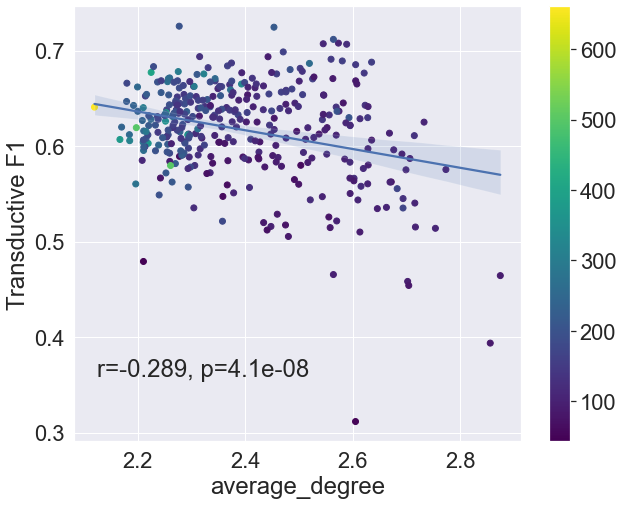

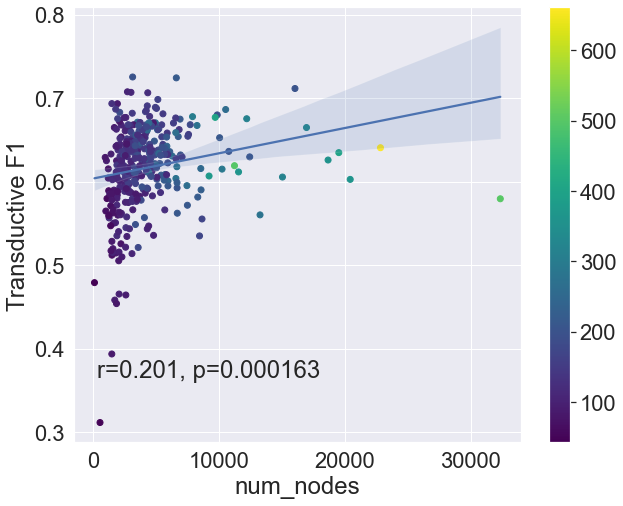

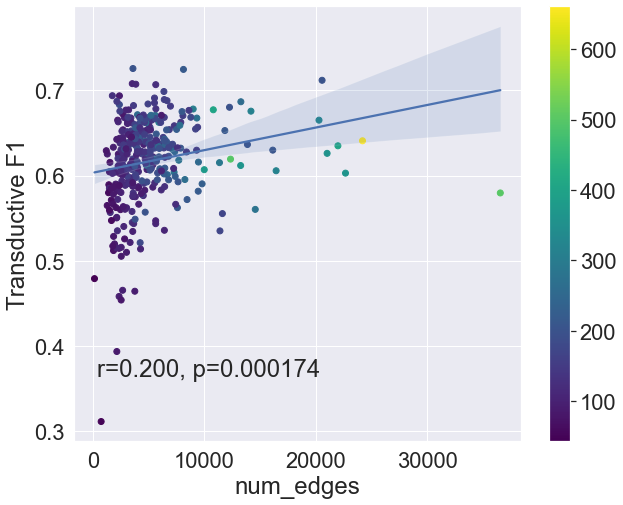

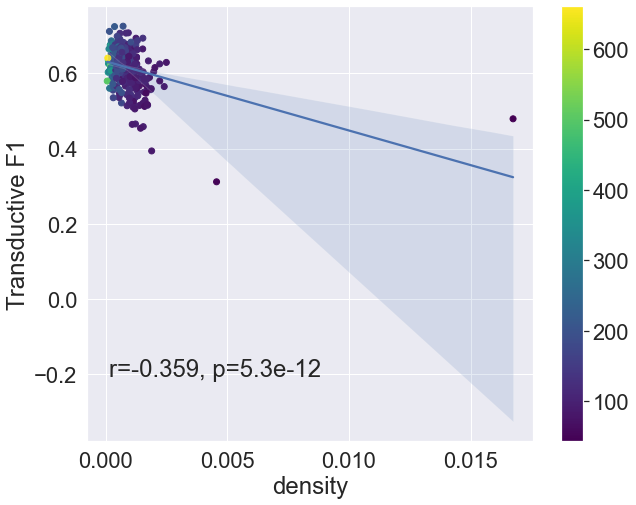

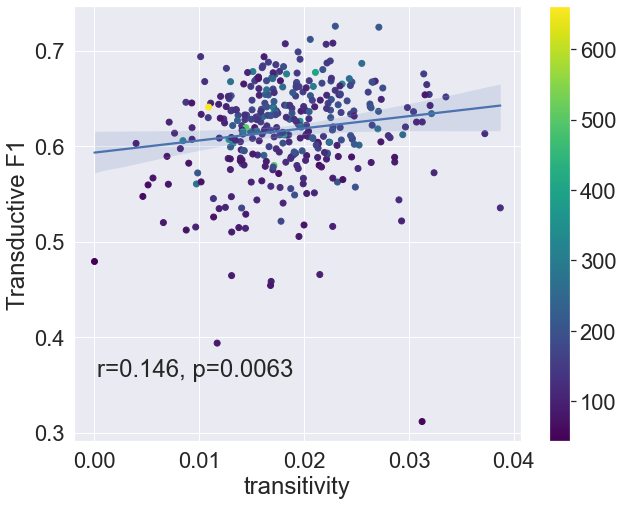

...

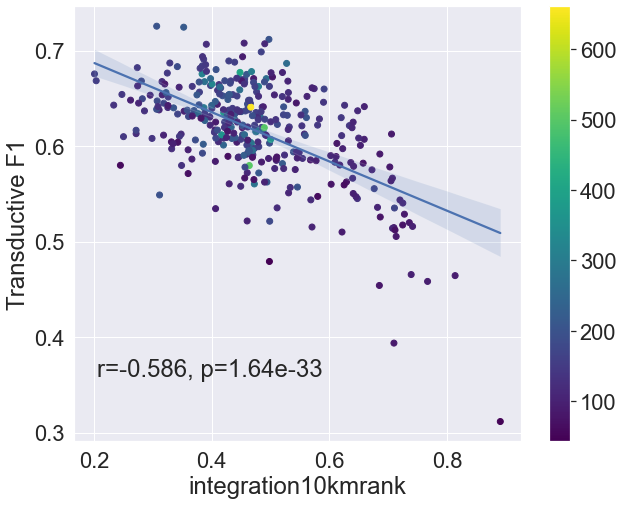

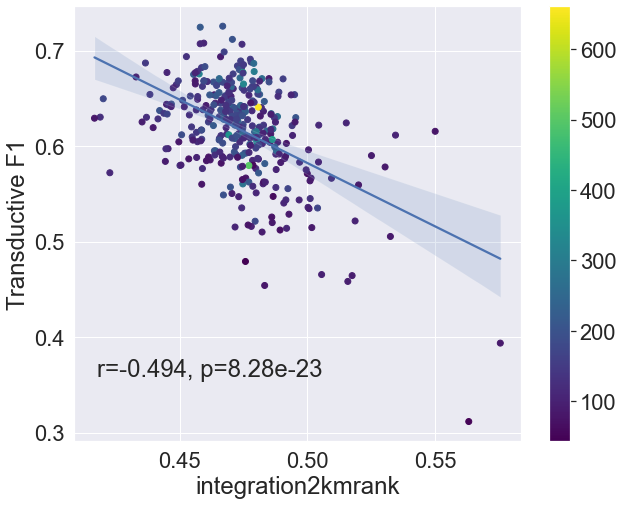

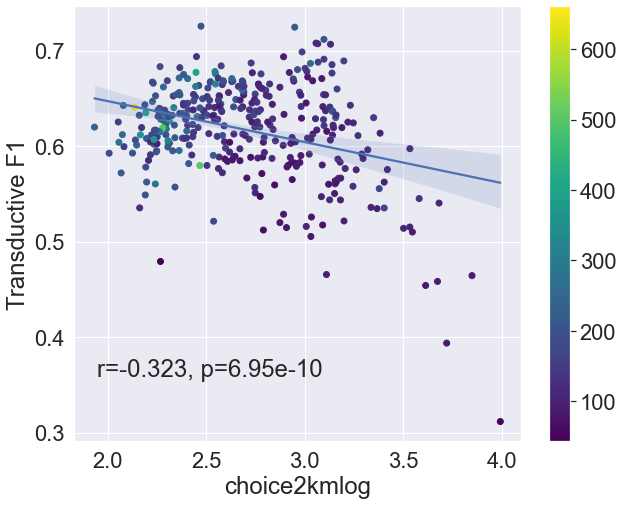

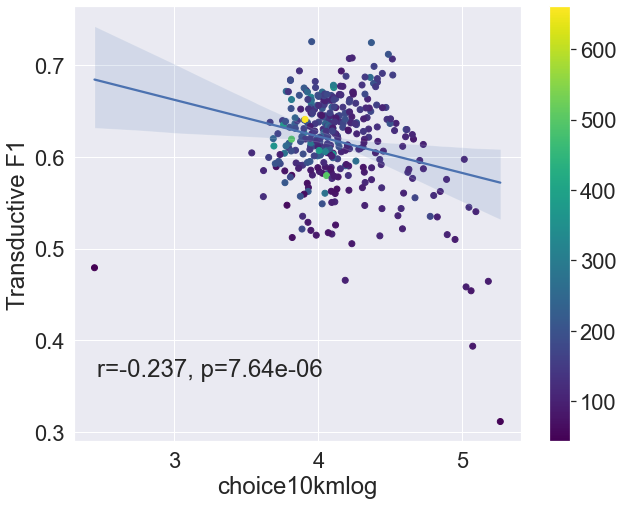

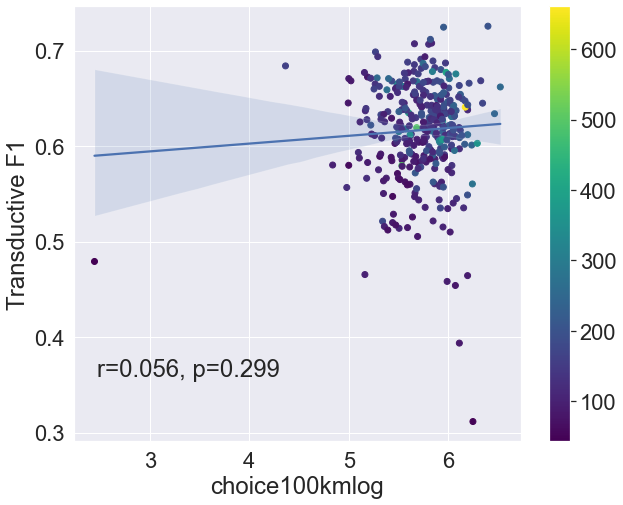

In [41]:
link_pred_dataseta = torch.load(f'{dataset_root}/link_pred_metrics_full_GAIN_iter1.pt')
link_pred_datasetb = torch.load(f'{dataset_root}/link_pred_metrics_full_GAIN_iter2.pt')
link_pred_dataset = {**link_pred_dataseta, **link_pred_datasetb}

records = []
for place in link_pred_dataset:
    metric_dict = link_pred_dataset[place]
    record = { 'place': place }
    metrics = [('auc', 'AUC'), ('ap', 'AP'), ('precision', 'Precision'), ('recall', 'Recall'), 
                ('f1', 'F1')]
    for key, metric in metrics:
        record[f'Transductive {metric}'] = metric_dict['transductive'][key]
    for key, metric in metrics:
        record[f'Inductive {metric}'] = metric_dict['inductive-avg'][key]
    records.append(record)
link_pred_df = pd.DataFrame.from_records(records)
net_df = pd.read_pickle(f'{dataset_root}/network_df.pt')
df = link_pred_df.merge(net_df, on='place')


# sns.set(rc={'figure.figsize':(15,10)}, font_scale=2)
# sns.boxplot(data=link_pred_df, orient="h", palette="Set2")
# plt.tight_layout()
# plt.savefig('link_pred_metrics.png')



stats = ['average_degree', 'num_nodes', 'num_edges', 'density', 'transitivity',
       'average_shortest_path_length', 'diameter']
ssx_stats = ['metres', 'choice2km',
       'nodecount2km', 'integration2km', 'choice10km', 'nodecount10km',
       'integration10km', 'choice100km', 'nodecount100km', 'integration100km',
       'choice2kmrank', 'choice10kmrank', 'integration10kmrank',
       'integration2kmrank', 'choice2kmlog', 'choice10kmlog',
       'choice100kmlog']
sns.set(font_scale=2)

def print_reg(df, stat_list, metric, add_txt='', col_field='diameter'):
    for stat in stat_list:
        new_txt = stat + add_txt
        df[new_txt] = df[stat]
        r, p = sp.stats.pearsonr(df[stat], df[metric])
        plt.figure(figsize=(10, 8))
        points = plt.scatter(df[new_txt], df[metric],
                     c=df[col_field], cmap='viridis')
        plt.colorbar(points)
        ax=plt.gca()
        sns.regplot(new_txt, metric, data=df, scatter=False, ax=ax)
        # sns.regplot(data=df, x=new_txt, y=metric, scatter_kws={'c':df[col_field], 'cmap': 'viridis', 'color': None, 'legend': True}, ax=ax)
        ax.text(.05, .15, 'r={:.3f}, p={:.3g}'.format(r, p),
                transform=ax.transAxes)
        plt.show()
print_reg(df, stats + ssx_stats, 'Transductive F1')

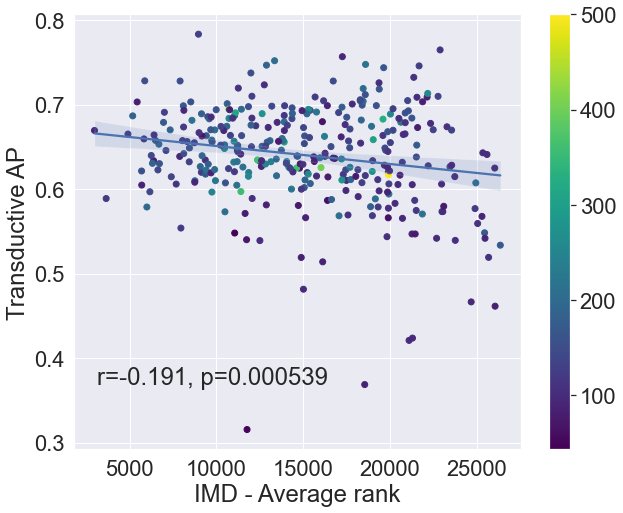

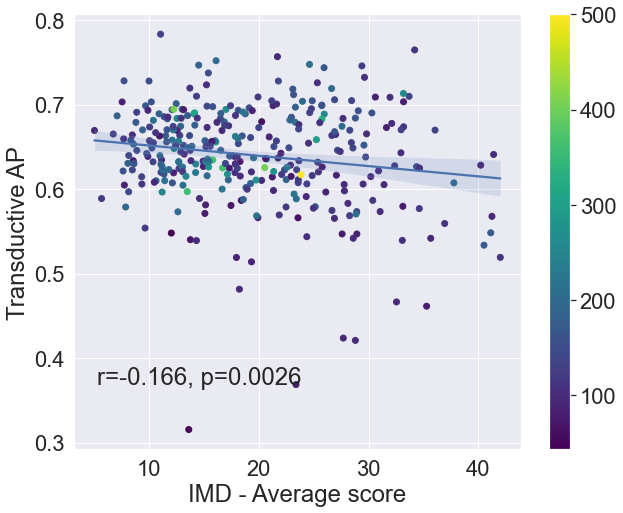

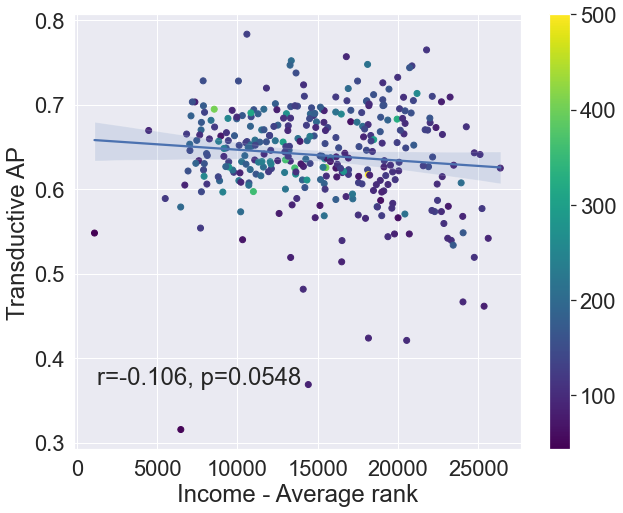

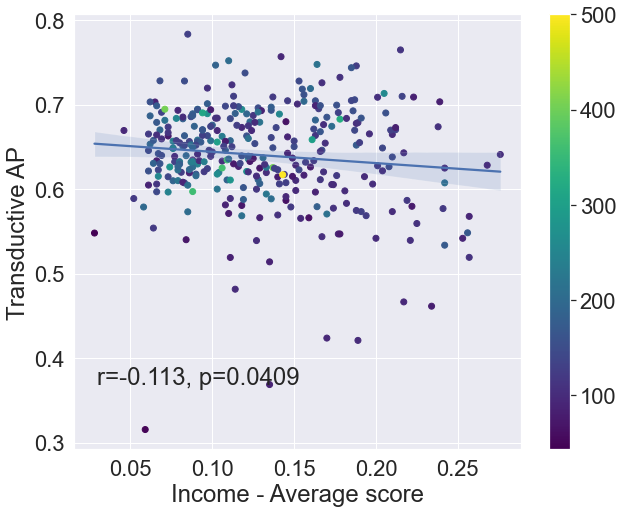

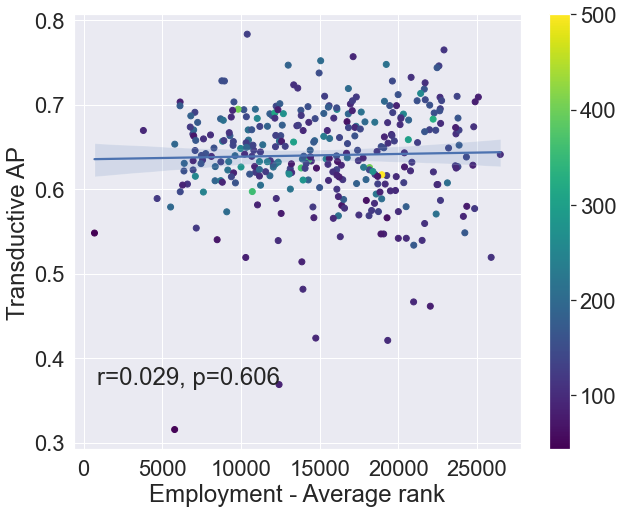

...

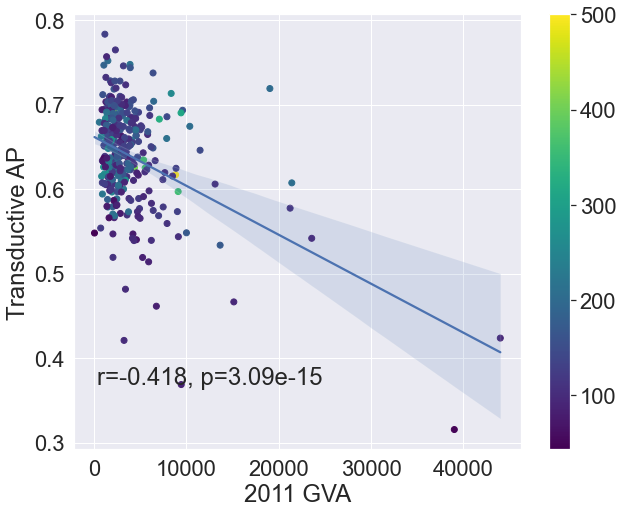

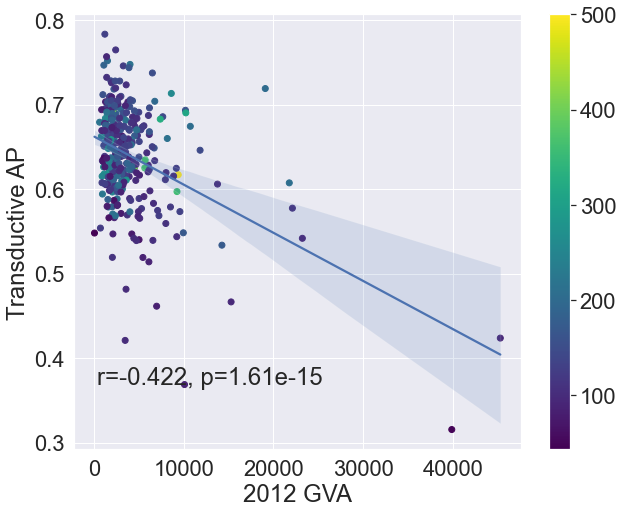

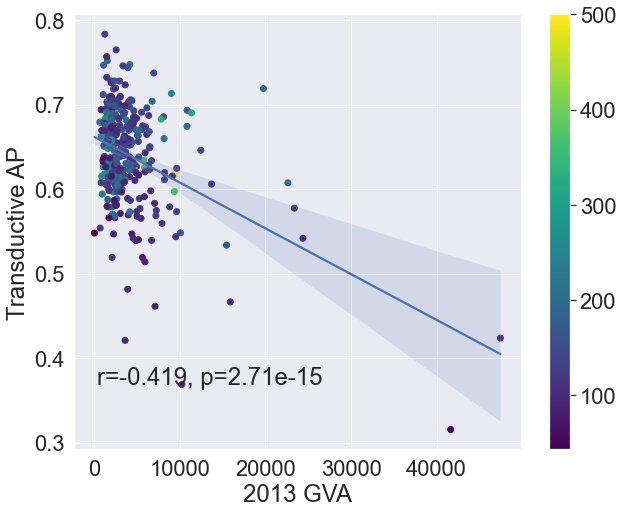

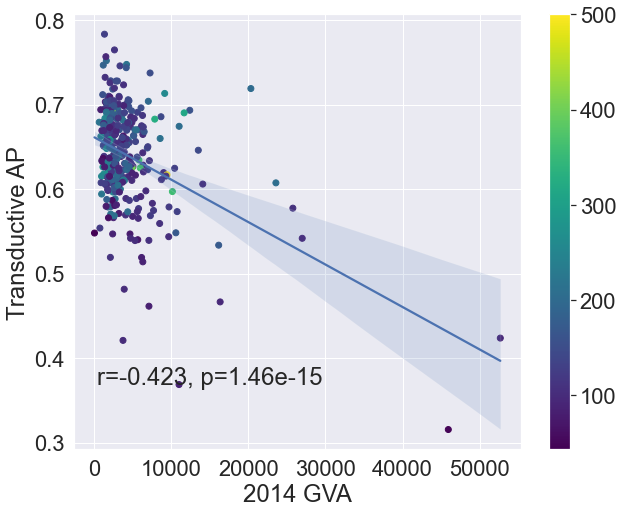

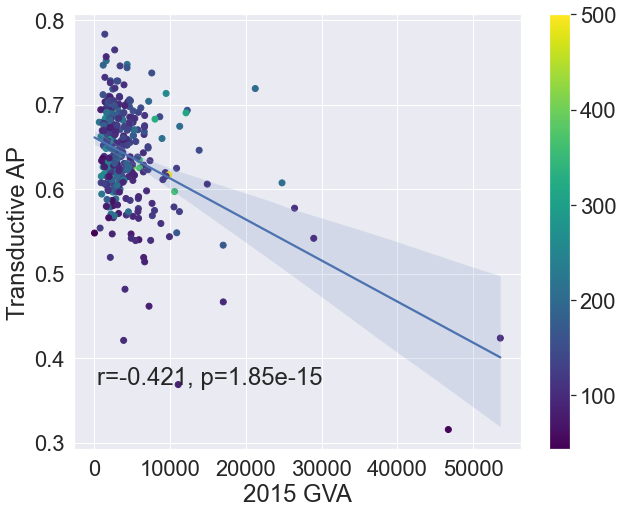

In [42]:
dep_df = load_deprivation_df()
gva_df = load_gva_df()
gva_df.columns = gva_df.columns.astype(str)
net_df = pd.read_pickle(f'{dataset_root}/network_df.pt')
df = link_pred_df.merge(net_df, on='place')
df = df.merge(dep_df, left_on='place', right_on='Local Authority District name (2013)')
df = df.merge(gva_df, left_on='place', right_on='LA name')

dep_stats = ['IMD - Average rank',
       'IMD - Average score', 'Income - Average rank',
       'Income - Average score', 'Employment - Average rank',
       'Employment - Average score',
       'Education, Skills and Training - Average rank',
       'Education, Skills and Training - Average score',
       'Health Deprivation and Disability - Average rank',
       'Health Deprivation and Disability - Average score',
       'Crime - Average rank', 'Crime - Average score',
       'Barriers to Housing and Services - Average rank',
       'Barriers to Housing and Services - Average score',
       'Living Environment - Average rank',
       'Living Environment - Average score',
       'Income Deprivation Affecting Children Index (IDACI) - Average rank',
       'Income Deprivation Affecting Children Index (IDACI) - Average score',
       'Income Deprivation Affecting Older People (IDAOPI) - Average rank',
       'Income Deprivation Affecting Older People (IDAOPI) - Average score']
gva_stats = ['1997', '1998', '1999', '2000', '2001', '2002', '2003', '2004', '2005',
       '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014',
       '2015']

sns.set(font_scale=2)
print_reg(df, dep_stats, 'Transductive AP')
print_reg(df, gva_stats, 'Transductive AP', add_txt=' GVA')

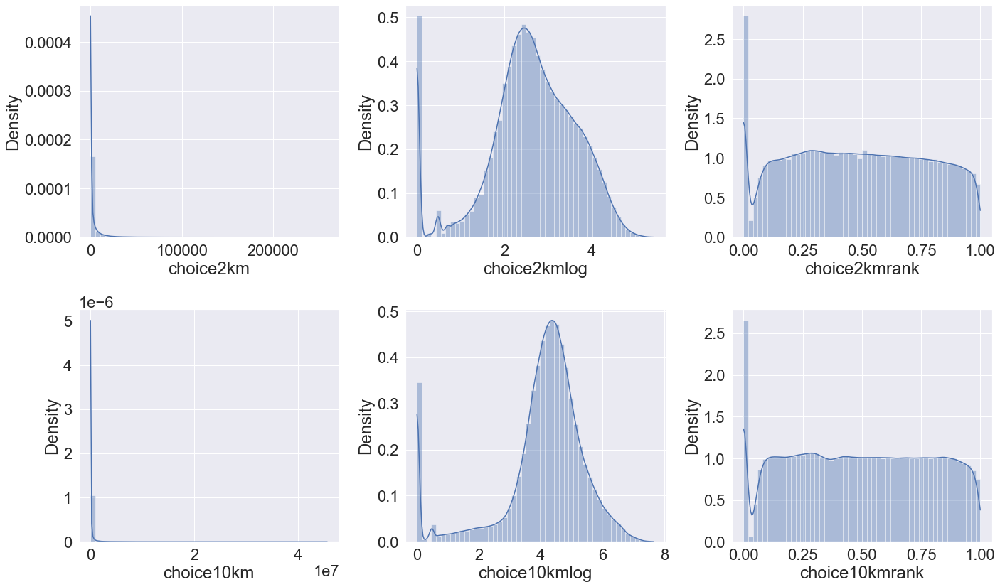

In [7]:
"""
View original SSX feature distributions
"""

# full_gdf = load_gdf('No Bounds', clean=False, ignore_fields=fields_to_ignore)
fig, axs = plt.subplots(2, 3, figsize=(20,12))
axs0, axs1 = axs[0], axs[1]

kde_kws = {'cut': 0}
sns.set(font_scale=2)
sns.distplot(full_gdf['choice2km'], ax=axs0[0], kde_kws=kde_kws)
sns.distplot(full_gdf['choice2kmlog'], ax=axs0[1], kde_kws=kde_kws)
sns.distplot(full_gdf['choice2kmrank'], ax=axs0[2], kde_kws=kde_kws)
sns.distplot(full_gdf['choice10km'], ax=axs1[0], kde_kws=kde_kws)
sns.distplot(full_gdf['choice10kmlog'], ax=axs1[1], kde_kws=kde_kws)
sns.distplot(full_gdf['choice10kmrank'], ax=axs1[2], kde_kws=kde_kws)
plt.tight_layout()
plt.savefig('choice_plot.png')

"""
View post-aggregation (simplification) SSx feature distributions
"""
aggs = ['sum', 'max', 'min', 'mean', 'median']
attrs = all_feature_fields
# graph_dict = {}
# for agg in aggs:
#     graph_dict[agg] = load_graph('No Bounds',
#                       feature_fields=all_feature_fields,
#                       force_connected=True,
#                       approach='dual',
#                       clean=True,
#                       clean_agg=agg,
#                       dist=50,
#                       cat_fields=['meridian_class'],
#                       target_field='accident_count',
#                       verbose=True)


kde_kws = {'cut': 0}
def plot_attr_distribution(g, attr, label=None, ax=None):
    # if ax = None:
    idx = g.node_attrs.index(attr)
    idx = torch.tensor(idx)
    xs = torch.index_select(g.x, 1, idx)
    ax = sns.distplot(xs.numpy(), ax=ax, label=label, hist=False, kde_kws=kde_kws)
    return ax


sns.set(font_scale=1.5)
for attr in attrs:
    _, ax = plt.subplots(1, 1, figsize=(10,10))
    for agg in aggs:
        ax = plot_attr_distribution(graph_dict[agg], attr, label=agg)
    # ax.set_yscale('log')
    ax.set_xscale('log')
    plt.title(attr)
    plt.legend()
    plt.show()

Loading Birmingham from SSx


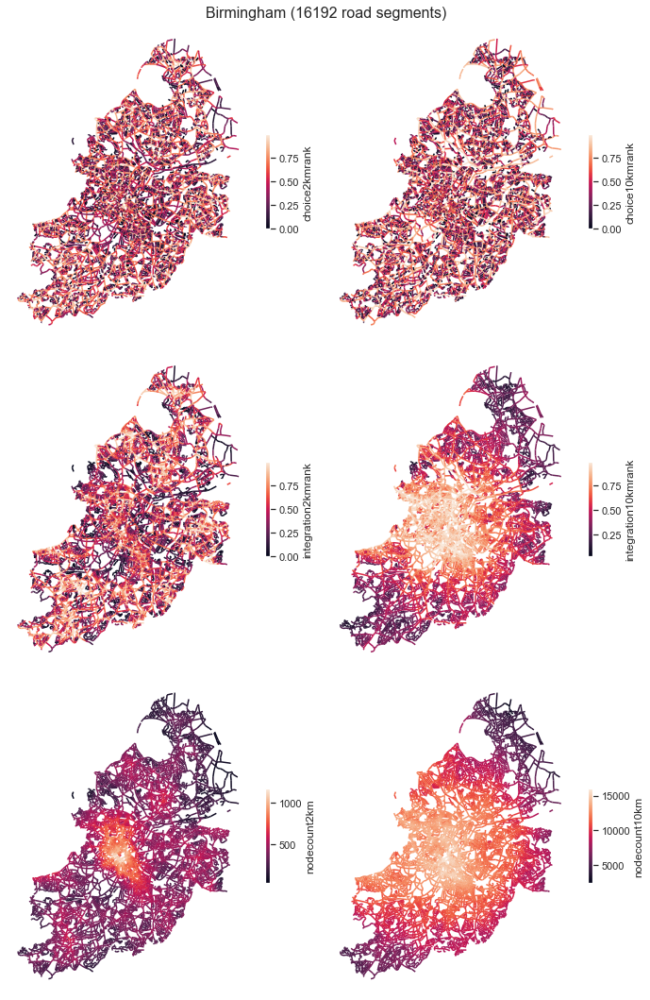

In [37]:
features = ['choice2km', 'choice10km', 'integration2km', 'integration10km', 'nodecount2km', 'nodecount10km']
place = 'Coventry'
gdf = load_gdf(place)
fig, axs = plt.subplots(3, 2, figsize=(10,15))
plt.suptitle(f'{place} ({len(gdf)} road segments)', fontsize='16')
i=0
for axs1 in axs:
    for ax in axs1:
        ax.axis('off')
        feature=features[i]
        i += 1
        gdf.plot(ax=ax,
                 column=feature,
                 legend=True, 
                 legend_kwds={
                     'label': feature,
                     'shrink': 0.3
                 },)

plt.tight_layout()
plt.savefig('./birmingham.png')

Cleaning graph with OSMnx...
Cleaning graph with OSMnx...
Cleaning graph with OSMnx...
Cleaning graph with OSMnx...


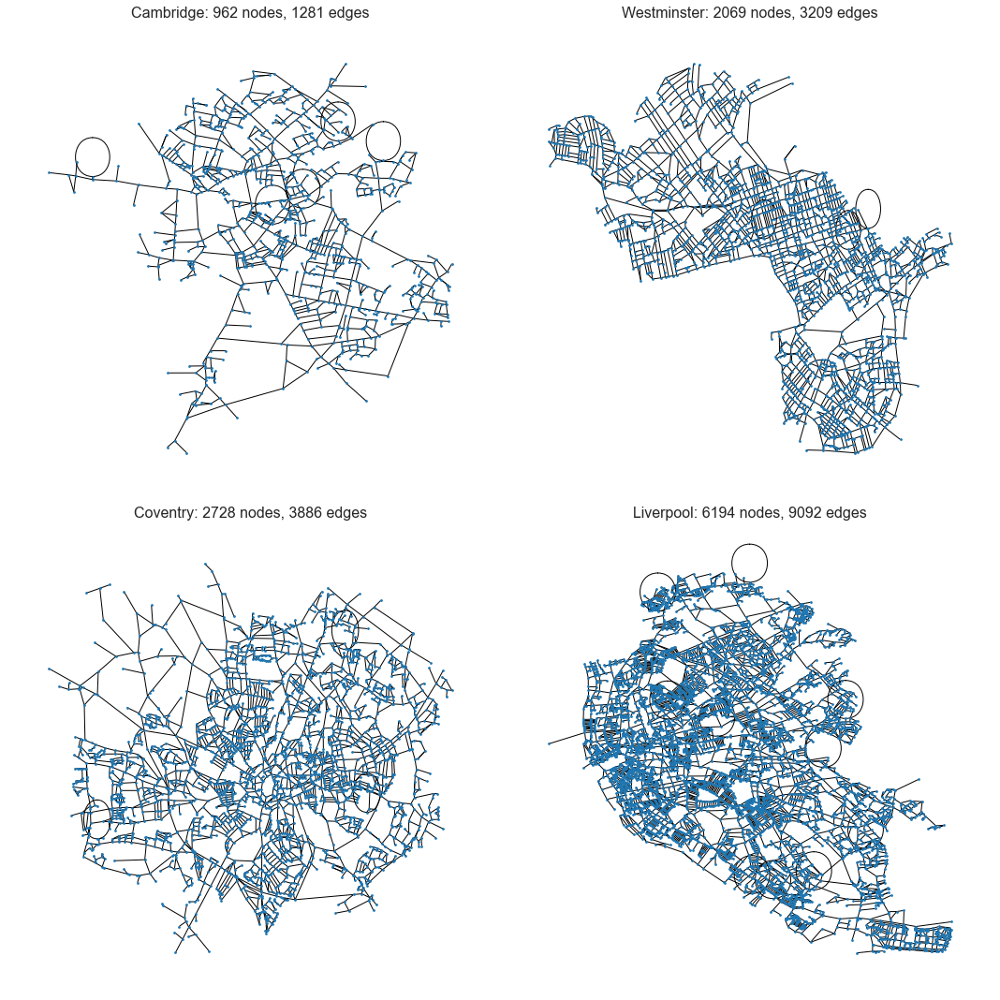

In [6]:
places = ['Cambridge', 'Westminster', 'Coventry', 'Birmingham']
fig, axs = plt.subplots(2, 2, figsize=(15,15))
# plt.suptitle(f'{place} ({len(gdf)} road segments)', fontsize='16')
i=0
for axs1 in axs:
    for ax in axs1:
        ax.axis('off')
        place=places[i]
        G = load_graph(place, reset=True, return_nx=True)
        # _, gdf = momepy.nx_to_gdf(G)
        i += 1
        
        ax.set_title(f'{place}: {G.number_of_nodes()} nodes, {G.number_of_edges()} edges',
                    fontsize=16)
        nx.draw(G, {n:[n[0], n[1]] for n in list(G.nodes)}, node_size=3, ax=ax)
plt.tight_layout()
plt.savefig('./ssx_graphs.png')

Loading graph of Cambridge with key ('Cambridge', '[]', None, 'primal', False, 'min', True, 50, True)...
Loading Cambridge from SSx
43217 geometries retrieved from Cambridge
Generated graph with 1521 nodes and 1856 edges
Node features: ['LA_id', 'x', 'y']
Node target: None
Edge attributes: {'LA_id', 'choice10km', 'metres', 'mm_len', 'v', 'choice100kmlog', 'choice2kmlog', 'integration10kmrank', 'lad11nm', 'choice100km', 'nodecount100km', 'choice10kmlog', 'lad11cd', 'u', 'choice2kmrank', 'accident_count', 'choice10kmrank', 'integration10km', 'integration2kmrank', 'integration100km', 'geometry', 'meridian_class', 'nodecount10km', 'nodecount2km', 'choice2km', 'integration2km'}
Loading graph of Cambridge with key ('Cambridge', '[]', None, 'primal', True, 'min', True, 50, True)...
Loading Cambridge from SSx
43217 geometries retrieved from Cambridge
Cleaning graph with OSMnx...
Generated graph with 962 nodes and 1281 edges
Node features: ['LA_id', 'x', 'y']
Node target: None
Edge attributes: 

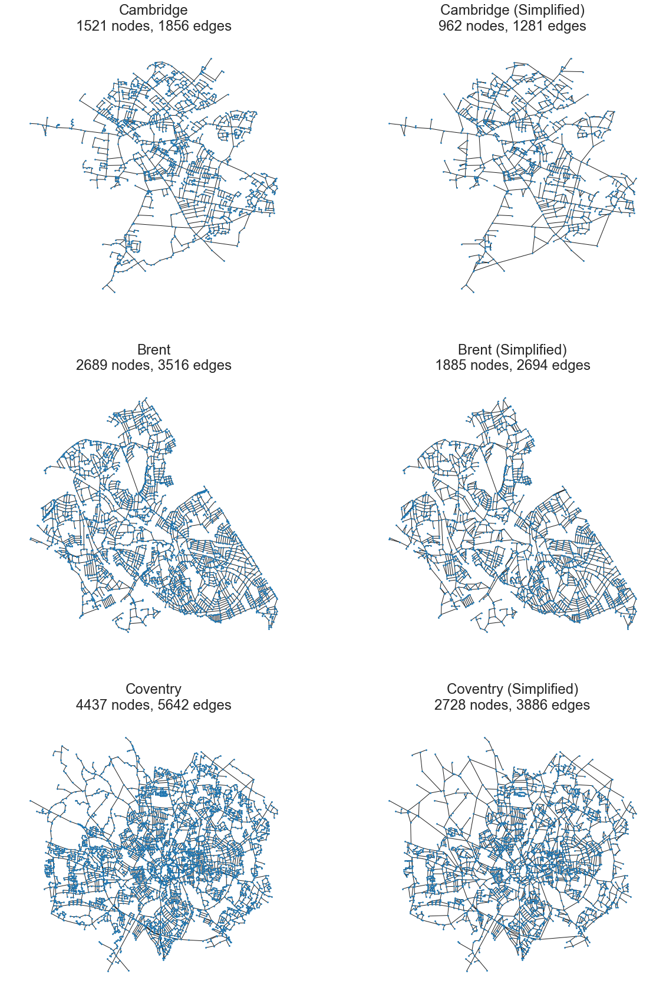

In [62]:
places = ['Cambridge', 'Brent', 'Coventry']
fig, axs = plt.subplots(len(places), 2, figsize=(20, len(places)*10))
# plt.suptitle(f'{place} ({len(gdf)} road segments)', fontsize='16')
sns.set(font_scale=2)
for i, axs1 in enumerate(axs):
    place=places[i]
    G = load_graph(place, clean=False, reset=True, return_nx=True)
    clean_G = load_graph(place, clean=True, reset=True, return_nx=True)
    axs1[0].set_title(f'{place}\n{G.number_of_nodes()} nodes, {G.number_of_edges()} edges')
    axs1[1].set_title(f'{place} (Simplified)\n{clean_G.number_of_nodes()} nodes, {clean_G.number_of_edges()} edges')

    visualize_nx(G, ax=axs1[0], node_size=3)
    visualize_nx(clean_G, ax=axs1[1], node_size=3)
plt.savefig('./ssx_clean_graphs.png', bbox_inches='tight')

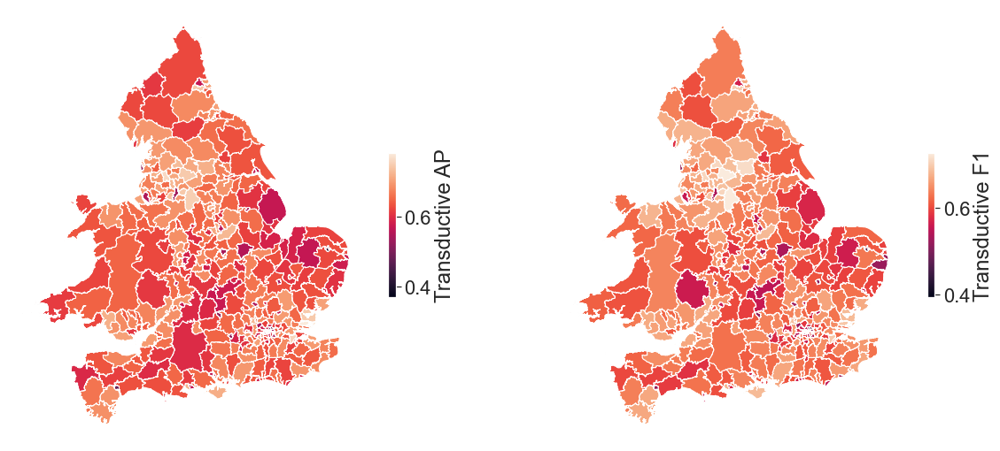

In [67]:
# link_pred1 = torch.load(f'{dataset_root}/link_pred/transductive_metrics_primal_1.pt')
# link_pred2 = torch.load(f'{dataset_root}/link_pred/transductive_metrics_primal_2.pt')
# link_pred = {**link_pred1, **link_pred2}
THRESH = 0.5
mean_f1s, mean_aps = [], []
for place in link_pred:
    pr_curves = link_pred[place]['pr']
    f1s = []
    aps = []
    for precs, recs, thresholds in pr_curves:
        for idx, threshold in enumerate(thresholds):
            if threshold < THRESH:
                p, r = precs[idx], recs[idx]
                f1 = 2 * p * r / (p + r)
                f1s.append(f1)
                break
        ap = np.sum(np.diff(recs) * np.array(precs)[:-1])
        aps.append(ap)
    mean_f1 = sum(f1s) / len(f1s)
    link_pred[place]['mean_f1'] = mean_f1
    mean_f1s.append(mean_f1)
    mean_ap = sum(aps) / len(aps)
    # mean_ap = sum(link_pred[place]['train_ap']) / len(link_pred[place]['train_ap'])
    # link_pred[place]['mean_ap'] = mean_ap
    mean_aps.append(mean_ap)

def vizualize_metric(link_pred_dataset, LA_gdf):
    metrics = [('mean_ap', 'AP'), ('mean_f1', 'F1')]
    for place in link_pred_dataset:
        place_metrics = link_pred_dataset[place]
        for key, metric in metrics:
            LA_gdf.loc[(LA_gdf.geo_label == place), metric] \
                = place_metrics[key]
    
    exceptions = {
        'Cornwall,Isles of Scilly': ('Cornwall', 'Isles of Scilly'),
        'City of London,Westminster': ('City of London', 'Westminster')
    }
    for combined_place in exceptions:
        places = exceptions[combined_place]
        for key, metric in metrics:
            LA_gdf.loc[(LA_gdf.geo_label == combined_place), metric] \
                = sum(link_pred_dataset[place][key] for place in places) / 2
    
    fig, axs = plt.subplots(1, 2, figsize=(20,10))
    i = 0
    for ax in axs:
        ax.axis('off')
        metric = metrics[i][1]
        i += 1
        LA_gdf.plot(
            ax=ax,
            column=metric,
            legend=True,
            figsize=(15,15),
            legend_kwds={
                'label': metric,
                'shrink': 0.3
            }
        )
    plt.tight_layout()
    plt.savefig('ap_f1.png')
sns.set(font_scale=2)

r, p = sp.stats.pearsonr(np.array(mean_f1s), np.array(mean_aps))
_, ax = plt.subplots(1, 1, figsize=(10, 8))
g = sns.regplot(x=np.array(mean_f1s), y=np.array(mean_aps), ax=ax)
ax.text(.05, .15, 'r={:.3f}, p={:.3g}'.format(r, p),
        transform=ax.transAxes)
plt.show()

zipfile = f'zip://{dataset_root}/infuse_dist_lyr_2011_clipped.zip'
LA_gdf = gpd.read_file(zipfile)

# link_pred_dataseta = torch.load(f'{dataset_root}/link_pred_metrics_full_GAIN_iter1.pt')
# link_pred_datasetb = torch.load(f'{dataset_root}/link_pred_metrics_full_GAIN_iter2.pt')
# link_pred_dataset = {**link_pred_dataseta, **link_pred_datasetb}
truncated_LA_gdf = LA_gdf[LA_gdf.geo_label.isin(link_pred)].copy()
vizualize_metric(link_pred, truncated_LA_gdf)

Loading County Durham from SSx
1058928 geometries retrieved from County Durham
Loading Calderdale from SSx
424320 geometries retrieved from Calderdale
Loading Leeds from SSx
1074216 geometries retrieved from Leeds
Loading Gateshead from SSx
331968 geometries retrieved from Gateshead
Loading Crawley from SSx
114296 geometries retrieved from Crawley
Loading Ribble Valley from SSx
164684 geometries retrieved from Ribble Valley
Loading Islington from SSx
123240 geometries retrieved from Islington
Loading Solihull from SSx
254696 geometries retrieved from Solihull


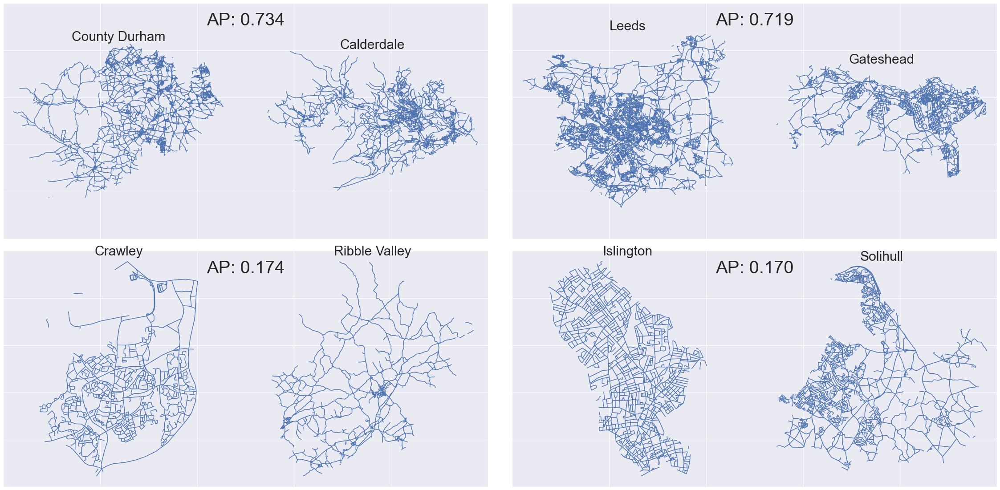

In [30]:
# Obtain graph pairs with high inductive AP
import matplotlib.gridspec as gridspec


link_pred_dataseta = torch.load(f'{dataset_root}/link_pred_metrics_full_GAIN_iter1.pt')
link_pred_datasetb = torch.load(f'{dataset_root}/link_pred_metrics_full_GAIN_iter2.pt')
link_pred_dataset = {**link_pred_dataseta, **link_pred_datasetb}
inductive_ap_dict = {}
k = 2
for train_place in link_pred_dataset:
    for test_place in link_pred_dataset[train_place]['inductive']:
        if train_place != test_place:
            inductive_ap = link_pred_dataset[train_place]['inductive'][test_place]['ap']
            inductive_ap_dict[train_place, test_place] = inductive_ap

top = sorted(inductive_ap_dict, key=inductive_ap_dict.get, reverse=True)
top_k = [top[0], top[2]]
bot_k = [top[-4],top[-2]]


fig = plt.figure(figsize=(40, 20))
outer = gridspec.GridSpec(2, 2, wspace=0.05, hspace=0.05)

for i in range(4):
    inner = gridspec.GridSpecFromSubplotSpec(1, 2,
                    subplot_spec=outer[i], wspace=0.1, hspace=0.1)
    
    pair = (top_k + bot_k)[i]
    
    ax = plt.Subplot(fig, outer[i])
    ax.set_title(f'AP: {inductive_ap_dict[pair]:.3f}', fontsize=40,
                 y=1.0, pad=-50)
    ax.tick_params(axis='both',which='both',bottom=0,left=0,
                    labelbottom=0, labelleft=0)
    fig.add_subplot(ax)
    for j in range(2):
        ax = plt.Subplot(fig, inner[j])
        gdf = load_gdf(pair[j])
        gdf.plot(ax=ax)
        ax.axis('off')
        ax.set_title(pair[j], fontsize=30, y=1.0, pad=-10)
        fig.add_subplot(ax)
plt.tight_layout()

    

plt.savefig(f'./inductive_ap_graphs.png', bbox_inches='tight')

In [ ]:
def add_deg_frac(net_df):
    for place in net_df['place']:
        G = load_graph(place, approach='primal', clean=True, return_nx=True, verbose=False)
        deg_counts = { 1: 0., 2: 0., 3:0., 4:0.}
        num_nodes = G.number_of_nodes()
        for i in (d for _, d in G.degree()):
            if i in deg_counts:
                deg_counts[i] += 1
        for deg in deg_counts:
            frac = deg_counts[deg] / num_nodes
            net_df.loc[net_df['place'] == place, f'{deg}_frac'] = frac

            
net_df = pd.read_pickle(f'{dataset_root}/network_df.pt')
add_deg_frac(net_df)

# Save the labels

In [3]:

net_df = pd.read_pickle(f'{dataset_root}/network_df_w_stats.pt')
net_df

,place,average_degree_connectivity,average_degree,num_nodes,num_edges,density,transitivity,average_shortest_path_length,diameter,metres,...,choice2kmlog,choice10kmlog,choice100kmlog,1_frac,2_frac,3_frac,4_frac,bridge,dead-end,cycle
0,Isle of Wight,"{2: 2.4038378611470463, 3: 2.6709897610921502,...",2.366810,4182,4949,0.000566,0.016060,63.784442,163,156.395949,...,2.575425,3.805418,4.363727,0.130412,0.097938,0.696907,0.072680,0.020478,0.095942,0.883580
1,Wycombe,"{2: 2.4207256461232602, 4: 2.5080645161290325,...",2.324953,3699,4300,0.000629,0.026304,47.811634,135,173.214141,...,2.513078,4.064301,5.890762,0.173464,0.109133,0.663986,0.052269,0.028723,0.133451,0.837826
2,Enfield,"{4: 2.8696172248803826, 3: 2.8258029395753947,...",2.574168,3546,4564,0.000726,0.019698,38.768955,101,118.360944,...,3.141558,4.538661,5.860223,0.105698,0.066116,0.741192,0.085689,0.016708,0.075186,0.908106
3,Slough,"{3: 2.713907284768212, 4: 2.767857142857143, 2...",2.450957,1672,2049,0.001467,0.020241,34.203381,93,116.378432,...,2.980563,4.209827,5.754433,0.156883,0.087045,0.688259,0.064777,0.031842,0.117513,0.850644
4,South Bucks,"{3: 2.5877570540411288, 1: 2.4597701149425286,...",2.334553,1913,2233,0.001221,0.032390,39.207242,114,176.069482,...,2.581380,4.324019,6.033098,0.194503,0.094080,0.652220,0.058140,0.054143,0.150943,0.794914
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,Canterbury,"{2: 2.430084745762712, 1: 2.3811475409836067, ...",2.377178,3558,4229,0.000668,0.017138,52.656259,126,169.247426,...,2.612731,4.001321,5.489586,0.150877,0.066667,0.697661,0.081871,0.022796,0.110968,0.866237
344,Ashford,"{2: 2.3563142194232682, 1: 2.3003300330033003,...",2.238002,4605,5153,0.000486,0.014956,54.335625,166,198.482458,...,2.395221,4.095796,5.939068,0.180425,0.112028,0.645047,0.059552,0.034106,0.139154,0.826739
345,Thanet,"{3: 2.8297236743838687, 1: 2.392857142857143, ...",2.582062,2687,3469,0.000961,0.009276,35.155572,83,126.805349,...,3.006976,4.023071,4.993758,0.086361,0.063133,0.748660,0.099464,0.012874,0.060216,0.926910
346,Dover,"{1: 2.3711340206185567, 3: 2.663088356729975, ...",2.390433,3345,3998,0.000715,0.019048,47.429184,131,179.959798,...,2.558347,3.975032,5.322519,0.126654,0.079395,0.707624,0.085066,0.018756,0.091949,0.889296


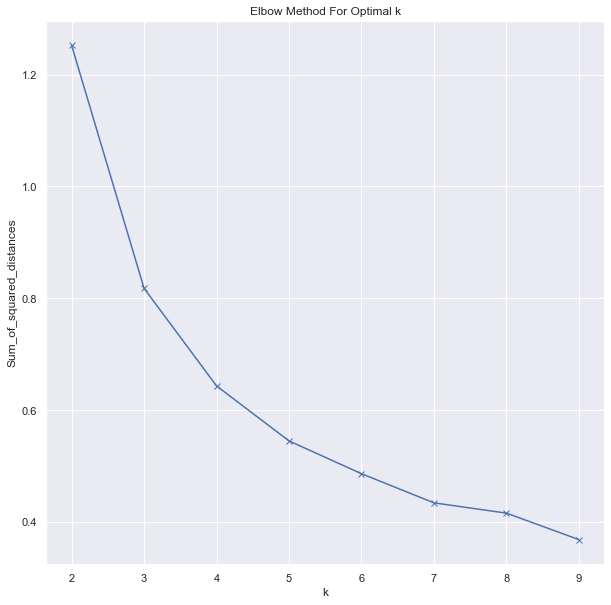

In [4]:
# stats_to_norm = ['average_degree','density', 'transitivity', 'average_shortest_path_length', 'diameter']
# net_df.loc[:,stats_to_norm] = net_df.loc[:,stats_to_norm].apply(lambda x: (x-x.mean())/ x.std(), axis=0)
from sklearn.cluster import KMeans
Ks = range(2,10)
errors = []

cols = [
    '1_frac',
    '2_frac',
    '3_frac',
    '4_frac',
    'bridge',
    'dead-end',
    'cycle',
]
for k in Ks:
    kmeans = KMeans(n_clusters=k, n_init=3, max_iter=3000, random_state=1)
    kmeans = kmeans.fit(net_df[cols])
    errors.append(kmeans.inertia_)
    net_df.loc[:,f'label_{k}'] = kmeans.labels_

fig, ax = plt.subplots(1, 1, figsize=(10,10))
ax.plot(Ks, errors, 'bx-')
ax.set_xlabel('k')
ax.set_ylabel('Sum_of_squared_distances')
ax.set_title('Elbow Method For Optimal k')
plt.show()

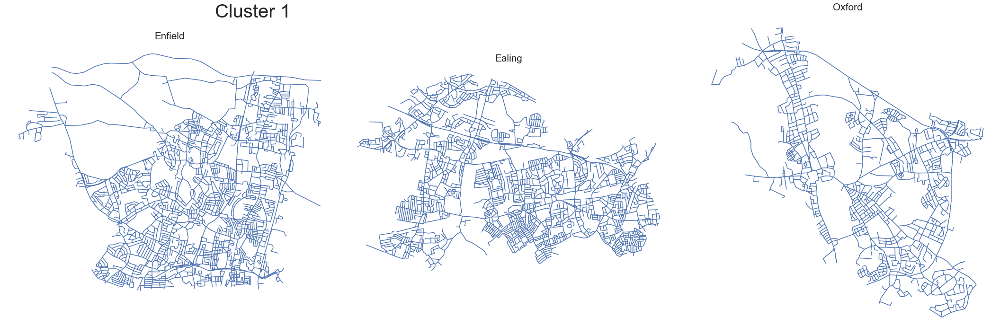

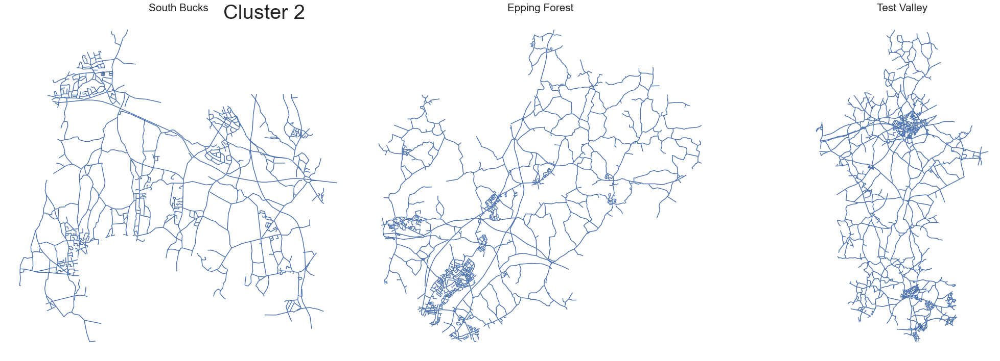

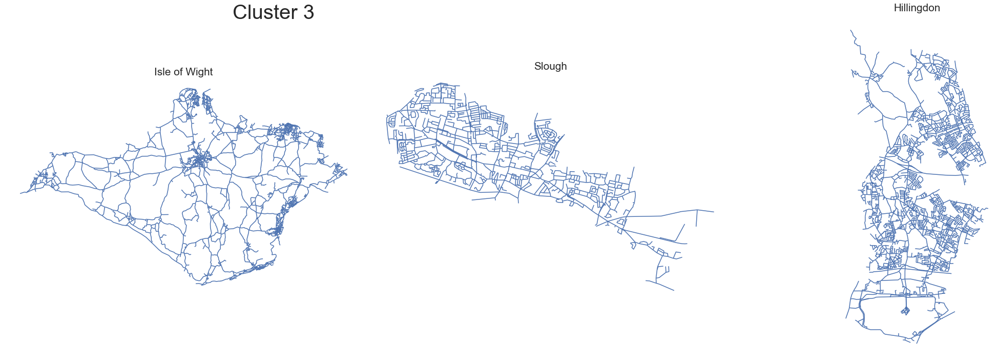

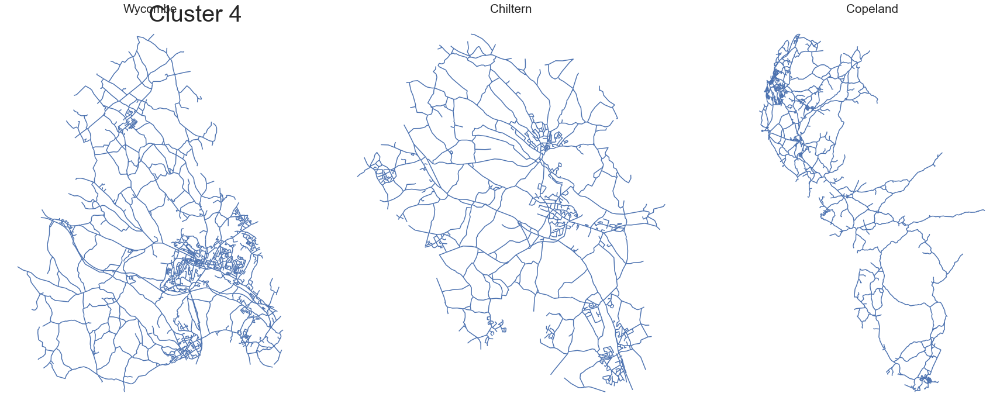

In [13]:
import warnings
warnings.filterwarnings('ignore')
params = {'axes.titlesize':'xx-large'}
plt.rcParams.update(params)
def show_samples(k=5, samples=3):
    label = f'label_{k}'
    for i in range(k):
        places = net_df[net_df[label] == i]['place'].values
        fig, axs = plt.subplots(1, samples, figsize=((samples*10, 10)))
        for idx, ax in enumerate(axs):
            if len(places) > idx:
                place = places[idx]
                ax.axis('off')
                ax.set_title(place, fontsize=40)
                visualize_graph(place, ax=ax)
        plt.tight_layout()
        plt.suptitle(f'Cluster {i+1}', fontsize=40, x=0.25)
        plt.show()
show_samples(k=4)

In [ ]:
for place in net_df['place']:
    G = load_graph(place, approach='primal', clean=True, return_nx=True, verbose=False)
    cycle_edges = [list(zip(nodes,(nodes[1:]+nodes[:1]))) for nodes in nx.cycle_basis(G)]
    edge_class = {
        'bridge': 0,
        'dead-end': 0,
        'self-loop': 0,
        'cycle': 0
    }
    for (u, v) in G.edges():
        found = False
        for cycle in cycle_edges:
            if (u, v) in cycle or (v, u) in cycle:
                found = True
        if found:
            # Cycle
            edge_class['cycle'] += 1
        else:
            if u == v:
                # Self Loop
                edge_class['self-loop'] += 1
            elif G.degree[u] == 1 or G.degree[v] == 1:
                # Dead end
                edge_class['dead-end'] += 1
            else:
                # Bridge
                edge_class['bridge'] += 1 
    print(edge_class)
    num_edges = G.number_of_edges()
   
    for c in edge_class:
        frac = edge_class[c] / num_edges
        net_df.loc[net_df['place'] == place, c] = frac

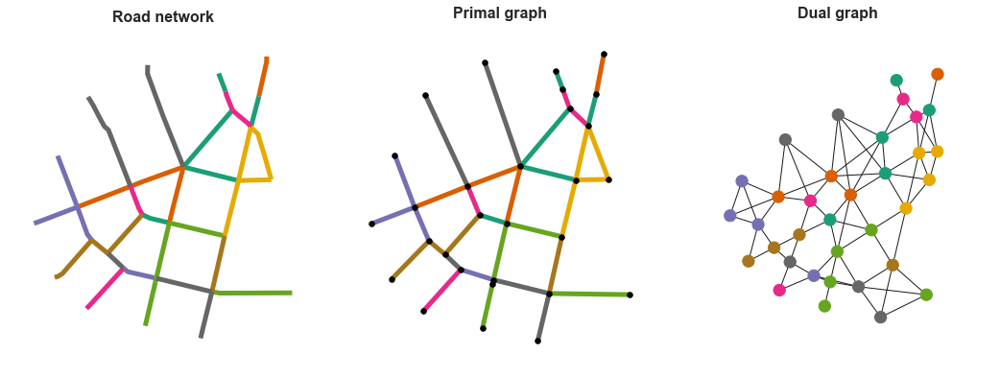

Loading Coventry from SSx
112920 geometries retrieved from Coventry


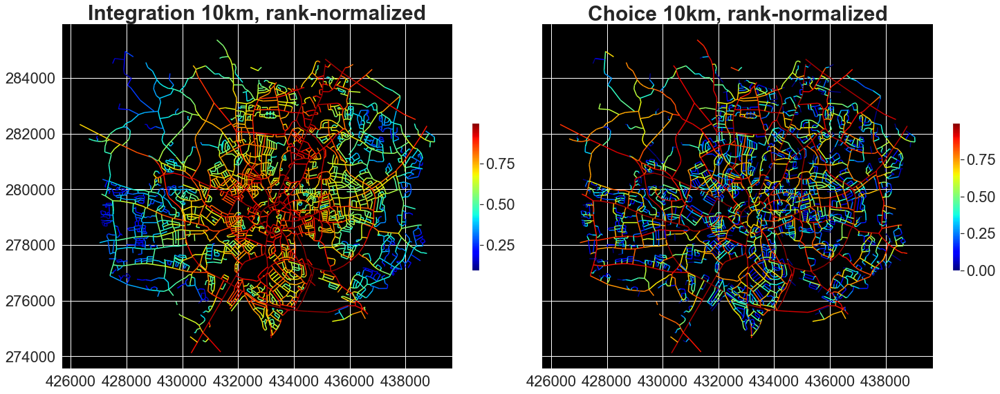

In [16]:
import momepy
from matplotlib import cm, colors

streets = gpd.read_file(momepy.datasets.get_path('bubenec'), layer='streets')
primal = momepy.gdf_to_nx(streets, approach='primal')
dual = momepy.gdf_to_nx(streets, approach='dual')

cols = []
cmap = cm.get_cmap('Dark2', streets.size)
for i in range(cmap.N):
    cols.append(colors.rgb2hex(cmap(i)))

f, ax = plt.subplots(1, 3, figsize=(15, 6), sharex=True, sharey=True)
streets.plot(color=cols, ax=ax[0], lw=5)
for i, facet in enumerate(ax):
    facet.set_title(("Road network", "Primal graph", "Dual graph")[i], fontweight="bold", size=16)
    facet.axis("off")

edge_colors = [cols[n] for (_, _, n) in list(primal.edges)]

node_colors = []
for i, d in list(dual.nodes(data=True)):
    first = d['geometry'].coords[0]
    last = d['geometry'].coords[-1]
    key = []
    for x, y, k, da in list(primal.edges(data=True, keys=True)):
        if d['geometry'] == da['geometry']:
            key.append(k)
    if len(key) != 0:
        node_colors.append(cols[key[0]])
    else:
        node_colors.append('black')
# node_colors = [cols[n] for (_, n) in list(dual.nodes)]
nx.draw(primal, {n:[n[0], n[1]] for n in list(primal.nodes)}, ax=ax[1], node_size=30, node_color='black', width=5, edge_color=edge_colors)
nx.draw(dual, {n:[n[0], n[1]] for n in list(dual.nodes)}, ax=ax[2], node_size=150, node_color=node_colors)

plt.tight_layout()
plt.savefig('primal_dual.png')
plt.show()

gdf = load_gdf('Coventry')
metrics = ['integration10kmrank', 'choice10kmrank']
sns.set(font_scale=2)
f, ax = plt.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True, constrained_layout=True)
for i, facet in enumerate(ax):
    gdf.plot(ax=facet, column=metrics[i], colormap='jet',
             legend=True, legend_kwds={ 'shrink': 0.3 })
    facet.set_title((r'Integration 10km, rank-normalized', r'Choice 10km, rank-normalized')[i], fontweight='bold', fontsize=30)
    facet.set_facecolor('black')
    for spine in facet.spines.values():
        spine.set_visible(False)
    # facet.tick_params(bottom=False, labelbottom=False,
    #            left=False, labelleft=False)
plt.savefig('integration_choice', bbox_inches='tight')

Loading Birmingham from SSx
841984 geometries retrieved from Birmingham


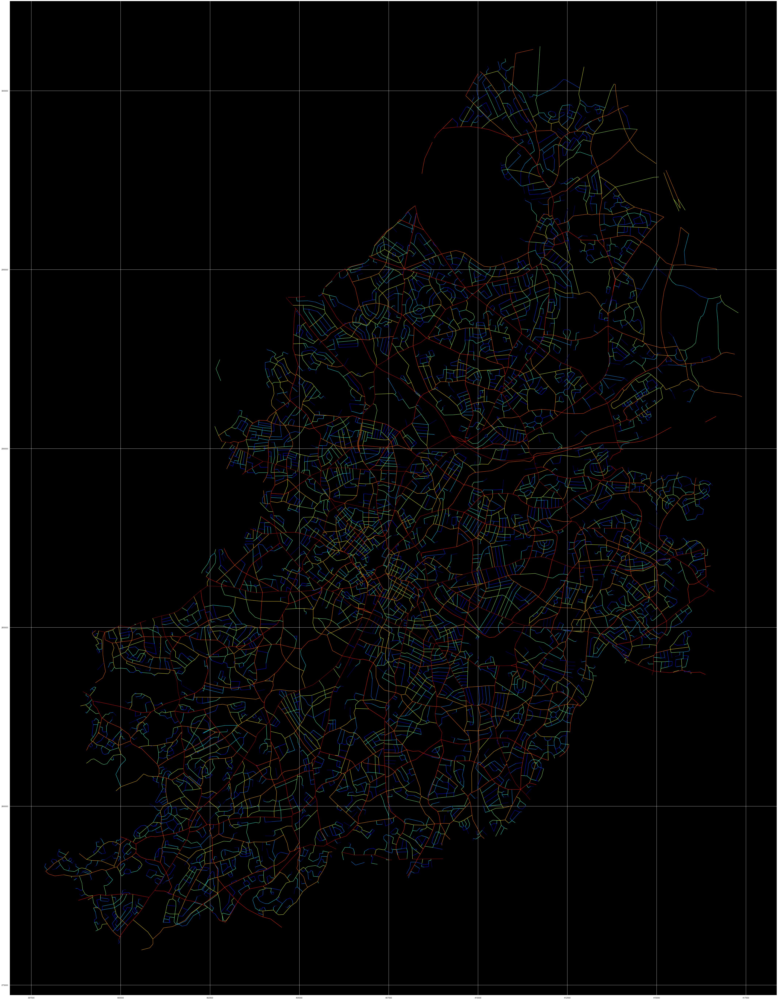

In [14]:
df = load_gdf('Birmingham')
metrics = ['integration10kmrank', 'choice10kmrank']
f, ax = plt.subplots(figsize=(100, 100))

df.plot(ax=ax, column='choice10kmrank', colormap='jet')
    # facet.set_title((r'Integration 10km, rank-normalized', r'Choice 10km, rank-normalized')[i], fontweight='bold', fontsize=30)
ax.set_facecolor('black')
for spine in ax.spines.values():
    spine.set_visible(False)
    # facet.tick_params(bottom=False, labelbottom=False,
    #            left=False, labelleft=False)
plt.savefig('birmingham_large', bbox_inches='tight')